# EDA, feature engineering, data transformations

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

In [2]:
#!pip install pandas_profiling
#!pip install ipywidgets
#!pip install plotly
#!pip install cufflinks
#!pip install chart_studio
import pandas_profiling
import cufflinks as cf
cf.go_offline()

In [3]:
cab = pd.read_csv("DataSets-main/Cab_Data.csv")
city = pd.read_csv("DataSets-main/City.csv")
customer = pd.read_csv("DataSets-main/Customer_ID.csv")
trans = pd.read_csv("DataSets-main/Transaction_ID.csv")

## Cab Data exploration

In [4]:
print("cab: ", cab.shape)
cab.head()

cab:  (359392, 7)


,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635
1,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854
2,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632
3,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602
4,10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776


In [5]:
cab.tail()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip
359387,10440101,43108,Yellow Cab,WASHINGTON DC,4.80,69.24,63.3600
359388,10440104,43104,Yellow Cab,WASHINGTON DC,8.40,113.75,106.8480
359389,10440105,43105,Yellow Cab,WASHINGTON DC,27.75,437.07,349.6500
359390,10440106,43105,Yellow Cab,WASHINGTON DC,8.80,146.19,114.0480
359391,10440107,43102,Yellow Cab,WASHINGTON DC,12.76,191.58,177.6192


In [6]:
#!pip install xlrd
# convert integer date to datetime
import xlrd
def date_conversion(d):
    date = xlrd.xldate_as_datetime(d, 0)
    return date.date()

In [7]:
cab["Date"] = cab["Date of Travel"].apply(date_conversion)

In [8]:
cab.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Date
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635,2016-01-08
1,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854,2016-01-06
2,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632,2016-01-02
3,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602,2016-01-07
4,10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776,2016-01-03


In [9]:
cab["Date"] = pd.to_datetime(cab["Date"], infer_datetime_format=True)

In [10]:
cab.dtypes

Transaction ID             int64
Date of Travel             int64
Company                   object
City                      object
KM Travelled             float64
Price Charged            float64
Cost of Trip             float64
Date              datetime64[ns]
dtype: object

In [11]:
cab.describe()

,Transaction ID,Date of Travel,KM Travelled,Price Charged,Cost of Trip
count,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000
mean,1.022076e+07,42964.067998,22.567254,423.443311,286.190113
std,1.268058e+05,307.467197,12.233526,274.378911,157.993661
min,1.000001e+07,42371.000000,1.900000,15.600000,19.000000
25%,1.011081e+07,42697.000000,12.000000,206.437500,151.200000
50%,1.022104e+07,42988.000000,22.440000,386.360000,282.480000
75%,1.033094e+07,43232.000000,32.960000,583.660000,413.683200
max,1.044011e+07,43465.000000,48.000000,2048.030000,691.200000


In [12]:
cab.describe(include="O")

,Company,City
count,359392,359392
unique,2,19
top,Yellow Cab,NEW YORK NY
freq,274681,99885


In [13]:
cab.isna().sum()

Transaction ID    0
Date of Travel    0
Company           0
City              0
KM Travelled      0
Price Charged     0
Cost of Trip      0
Date              0
dtype: int64

In [14]:
cab = cab.sort_values(by='Date',ascending=True)

In [15]:
cab.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Date
1030,10001340,42371,Yellow Cab,WASHINGTON DC,10.20,202.54,135.8640,2016-01-02
489,10000640,42371,Yellow Cab,CHICAGO IL,15.60,374.66,209.6640,2016-01-02
484,10000635,42371,Yellow Cab,CHICAGO IL,25.08,532.83,337.0752,2016-01-02
850,10001001,42371,Yellow Cab,NEW YORK NY,46.80,1391.91,595.2960,2016-01-02
160,10000171,42371,Pink Cab,SAN DIEGO CA,14.28,269.15,147.0840,2016-01-02


In [16]:
cab.tail()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Date
355489,10435011,43465,Yellow Cab,MIAMI FL,21.20,319.09,300.1920,2018-12-31
354114,10433309,43465,Pink Cab,LOS ANGELES CA,10.70,128.00,119.8400,2018-12-31
356365,10435915,43465,Yellow Cab,SACRAMENTO CA,27.14,374.95,377.7888,2018-12-31
359162,10439845,43465,Yellow Cab,TUCSON AZ,27.16,513.62,361.7712,2018-12-31
358336,10438644,43465,Yellow Cab,NEW YORK NY,3.45,77.13,49.6800,2018-12-31


In [17]:
# split city and state
cab['city'] = cab['City'].str[:-2]
cab['State'] = cab['City'].str[-2:]

In [18]:
cab.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Date,city,State
1030,10001340,42371,Yellow Cab,WASHINGTON DC,10.20,202.54,135.8640,2016-01-02,WASHINGTON,DC
489,10000640,42371,Yellow Cab,CHICAGO IL,15.60,374.66,209.6640,2016-01-02,CHICAGO,IL
484,10000635,42371,Yellow Cab,CHICAGO IL,25.08,532.83,337.0752,2016-01-02,CHICAGO,IL
850,10001001,42371,Yellow Cab,NEW YORK NY,46.80,1391.91,595.2960,2016-01-02,NEW YORK,NY
160,10000171,42371,Pink Cab,SAN DIEGO CA,14.28,269.15,147.0840,2016-01-02,SAN DIEGO,CA


In [19]:
cab.rename(columns={'City': 'City_State', 'city': 'City'}, inplace=True)

In [20]:
# no duplicates
cab.duplicated().unique()

array([False])

In [21]:
cab['State'].value_counts()

NY    99885
CA    70888
IL    56625
DC    43737
MA    29692
TX    11913
EY     8519
WA     7997
GA     7557
FL     6454
AZ     3995
TY     3982
CO     3825
TN     3010
PA     1313
Name: State, dtype: int64

In [22]:
# map state abbr to full state names
states = {
        'AZ': 'Arizona',
        'CA': 'California',
        'CO': 'Colorado',
        'DC': 'District of Columbia',
        'FL': 'Florida',
        'GA': 'Georgia',
        'IL': 'Illinois',
        'MA': 'Massachusetts',
        'NY': 'New York',
        'PA': 'Pennsylvania',
        'TN': 'Tennessee',
        'TX': 'Texas',
        'WA': 'Washington',
        'EY': 'California',
        'TY': 'California'
}

cab['State'] = cab['State'].map(states).fillna(cab['State'])

In [23]:
# fix two city names
def fix_city(v):
    if v == "ORANGE COUN":
        return "ORANGE COUNTY"
    elif v == "SILICON VALL":
        return "SILICON VALLEY"
    else:
        return v.strip()
    
cab['City'] = cab['City'].apply(fix_city)

In [24]:
cab["City"].value_counts()

NEW YORK          99885
CHICAGO           56625
LOS ANGELES       48033
WASHINGTON        43737
BOSTON            29692
SAN DIEGO         20488
SILICON VALLEY     8519
SEATTLE            7997
ATLANTA            7557
DALLAS             7017
MIAMI              6454
AUSTIN             4896
ORANGE COUNTY      3982
DENVER             3825
NASHVILLE          3010
SACRAMENTO         2367
PHOENIX            2064
TUCSON             1931
PITTSBURGH         1313
Name: City, dtype: int64

In [25]:
# retrieve new date features 
cab['Day Name'] = cab['Date'].dt.day_name()
cab['Month'] = cab['Date'].dt.month
cab['Year'] = cab['Date'].dt.year
cab['Week Day'] = cab['Date'].dt.weekday

In [26]:
cab.head()

,Transaction ID,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day
1030,10001340,42371,Yellow Cab,WASHINGTON DC,10.20,202.54,135.8640,2016-01-02,WASHINGTON,District of Columbia,Saturday,1,2016,5
489,10000640,42371,Yellow Cab,CHICAGO IL,15.60,374.66,209.6640,2016-01-02,CHICAGO,Illinois,Saturday,1,2016,5
484,10000635,42371,Yellow Cab,CHICAGO IL,25.08,532.83,337.0752,2016-01-02,CHICAGO,Illinois,Saturday,1,2016,5
850,10001001,42371,Yellow Cab,NEW YORK NY,46.80,1391.91,595.2960,2016-01-02,NEW YORK,New York,Saturday,1,2016,5
160,10000171,42371,Pink Cab,SAN DIEGO CA,14.28,269.15,147.0840,2016-01-02,SAN DIEGO,California,Saturday,1,2016,5


In [27]:
# get additional feature "is weekend" True/False
def is_weekend(day):
    if day == 5 or day == 6:
        return True
    else:
        return False

In [28]:
cab["Is Weekend"] = cab["Week Day"].apply(is_weekend)

In [29]:
cab.dtypes

Transaction ID             int64
Date of Travel             int64
Company                   object
City_State                object
KM Travelled             float64
Price Charged            float64
Cost of Trip             float64
Date              datetime64[ns]
City                      object
State                     object
Day Name                  object
Month                      int64
Year                       int64
Week Day                   int64
Is Weekend                  bool
dtype: object

In [171]:
#run profiling report
profile = cab.profile_report(title="Cab Data")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
#save new cab data
cab.to_csv("DataSets-main/Cab_clean.csv", index=False)

In [32]:
cab = pd.read_csv("DataSets-main/Cab_clean.csv")

In [33]:
cab.head()

,Transaction ID,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend
0,10001340,42371,Yellow Cab,WASHINGTON DC,10.20,202.54,135.8640,2016-01-02,WASHINGTON,District of Columbia,Saturday,1,2016,5,True
1,10000640,42371,Yellow Cab,CHICAGO IL,15.60,374.66,209.6640,2016-01-02,CHICAGO,Illinois,Saturday,1,2016,5,True
2,10000635,42371,Yellow Cab,CHICAGO IL,25.08,532.83,337.0752,2016-01-02,CHICAGO,Illinois,Saturday,1,2016,5,True
3,10001001,42371,Yellow Cab,NEW YORK NY,46.80,1391.91,595.2960,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True
4,10000171,42371,Pink Cab,SAN DIEGO CA,14.28,269.15,147.0840,2016-01-02,SAN DIEGO,California,Saturday,1,2016,5,True


In [34]:
cab["Date"] = pd.to_datetime(cab["Date"], infer_datetime_format=True)
cab.dtypes

Transaction ID             int64
Date of Travel             int64
Company                   object
City_State                object
KM Travelled             float64
Price Charged            float64
Cost of Trip             float64
Date              datetime64[ns]
City                      object
State                     object
Day Name                  object
Month                      int64
Year                       int64
Week Day                   int64
Is Weekend                  bool
dtype: object

In [35]:
import seaborn as sns

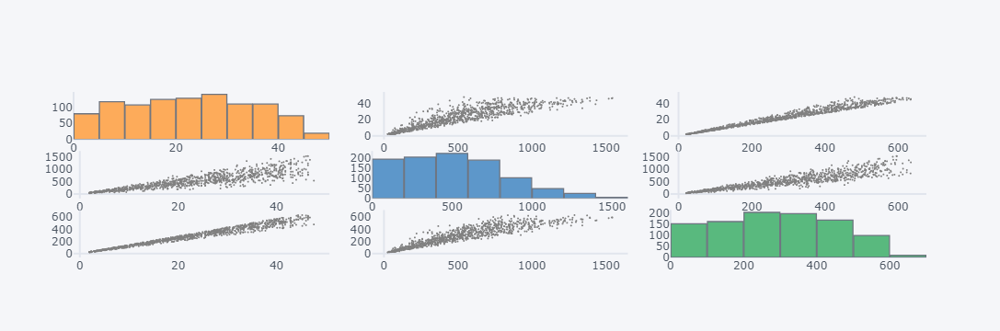

In [36]:
cab[['KM Travelled', 'Price Charged', 'Cost of Trip']][:1000].scatter_matrix(dimensions=["KM Travelled", "Price Charged", "Cost of Trip"])

In [173]:
corr = cab.corr()

cmap =sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

C:\Users\tigju\AppData\Local\Temp\ipykernel_13424\1154376203.py:17: FutureWarning:

this method is deprecated in favour of `Styler.format(precision=..)`



,Transaction ID,Date of Travel,KM Travelled,Price Charged,Cost of Trip,Month,Year,Week Day,Is Weekend
Transaction ID,1.00,0.99,-0.00,-0.05,-0.00,0.29,0.94,-0.07,-0.13
Date of Travel,0.99,1.00,-0.00,-0.06,-0.00,0.31,0.94,-0.07,-0.13
KM Travelled,-0.00,-0.00,1.00,0.84,0.98,-0.00,-0.00,0.00,0.00
Price Charged,-0.05,-0.06,0.84,1.00,0.86,-0.06,-0.04,0.05,0.04
Cost of Trip,-0.00,-0.00,0.98,0.86,1.00,-0.01,-0.00,0.00,0.00
Month,0.29,0.31,-0.00,-0.06,-0.01,1.00,-0.03,0.01,0.01
Year,0.94,0.94,-0.00,-0.04,-0.00,-0.03,1.00,-0.08,-0.14
Week Day,-0.07,-0.07,0.00,0.05,0.00,0.01,-0.08,1.00,0.78
Is Weekend,-0.13,-0.13,0.00,0.04,0.00,0.01,-0.14,0.78,1.00


In [38]:
group_state = cab.groupby('State')

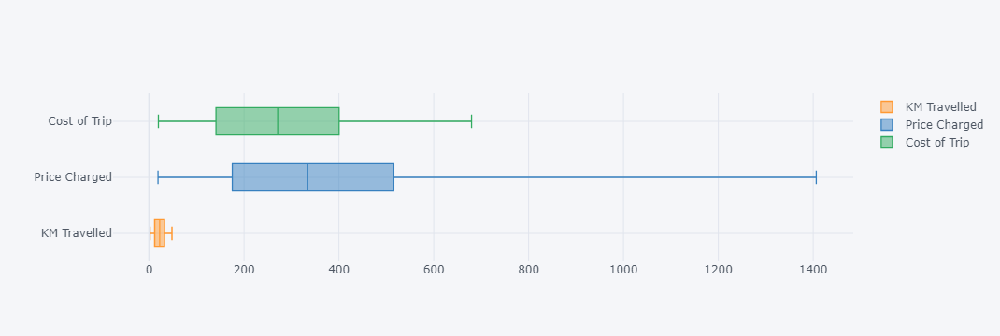

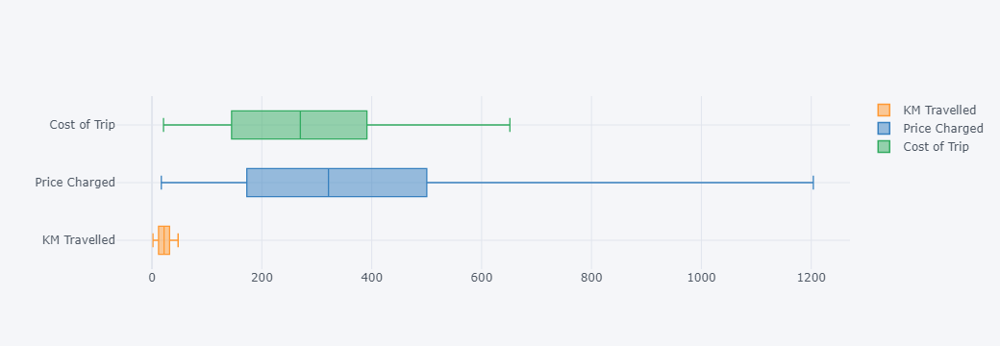

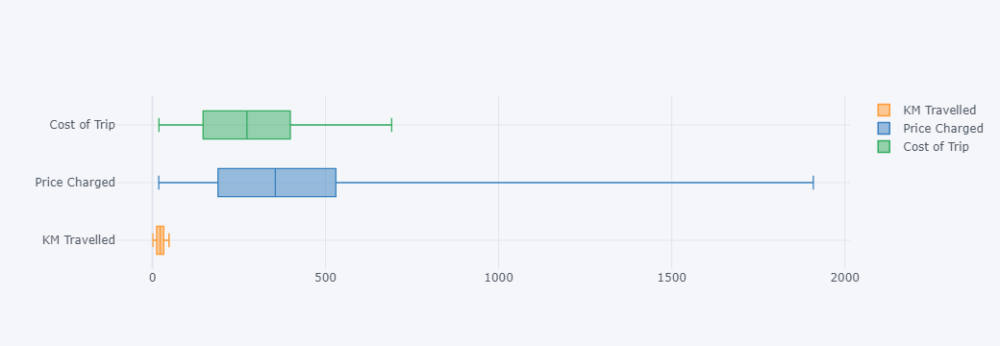

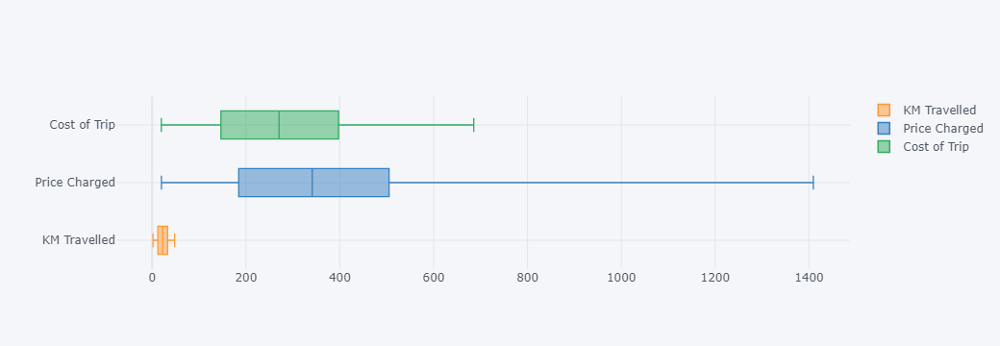

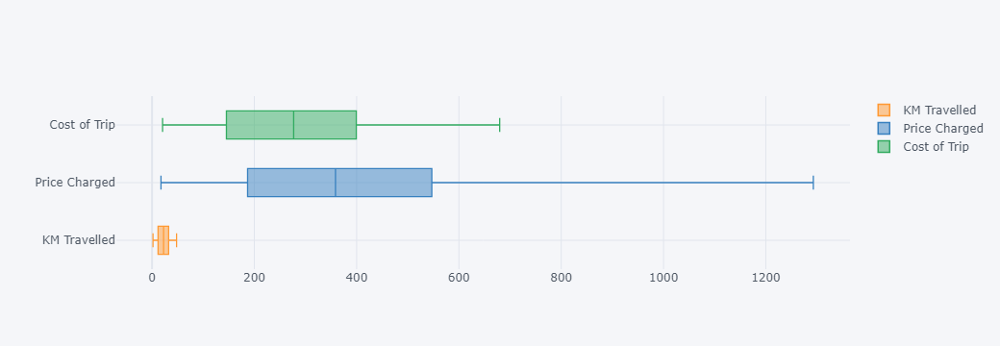

...

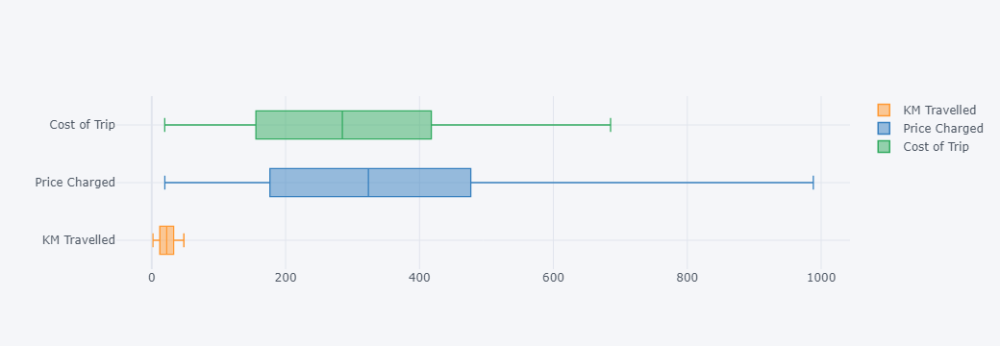

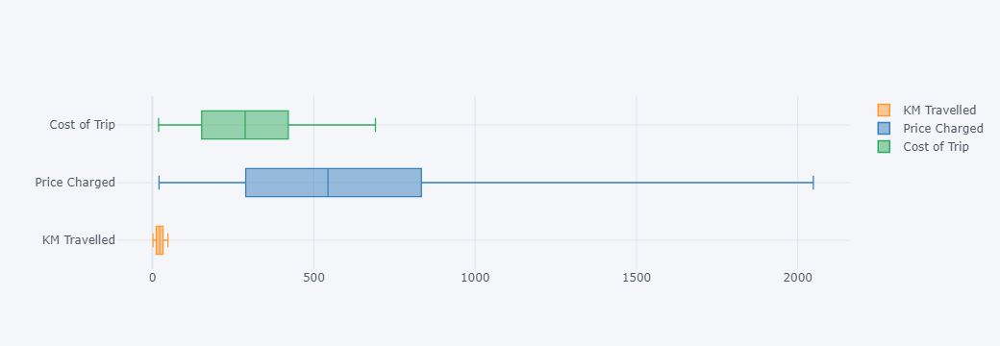

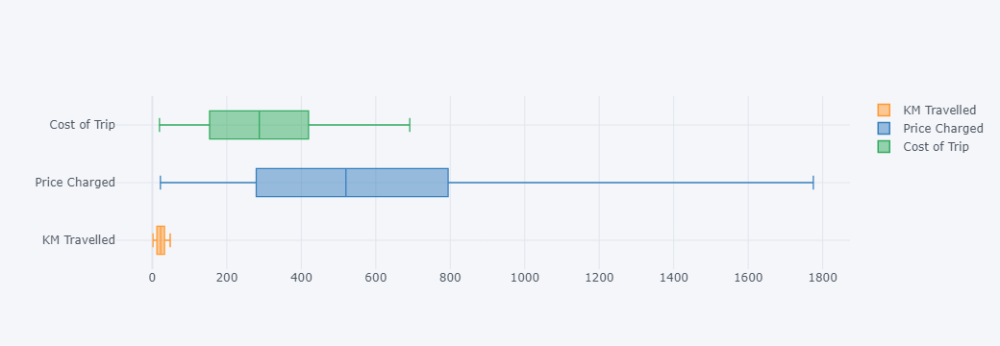

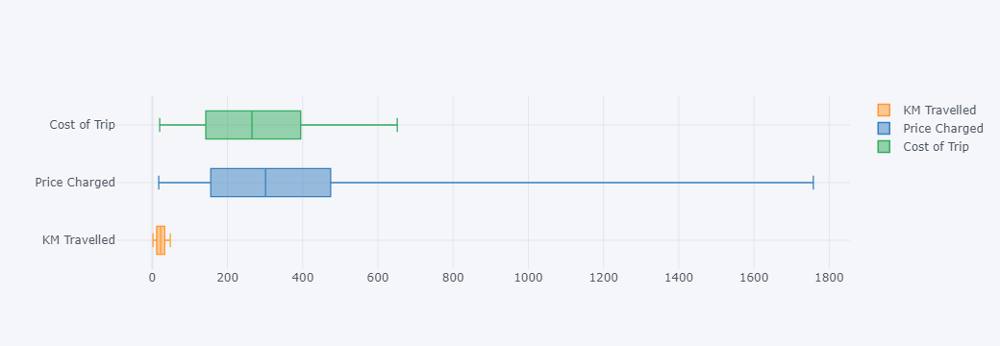

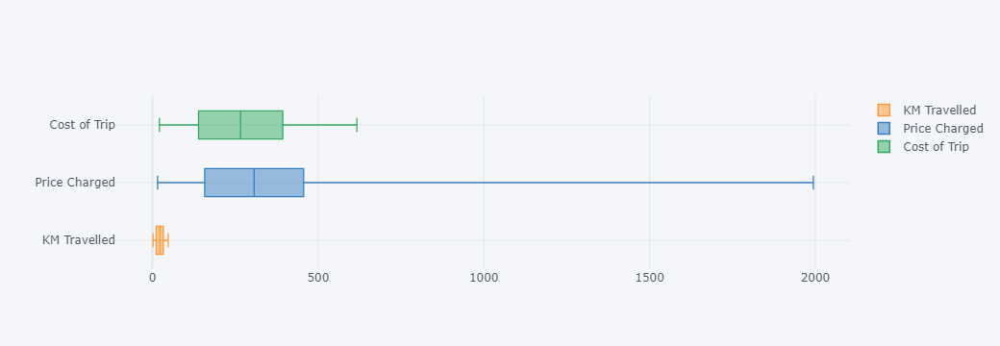

C:\Users\tigju\AppData\Local\Temp\ipykernel_13424\128417704.py:5: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



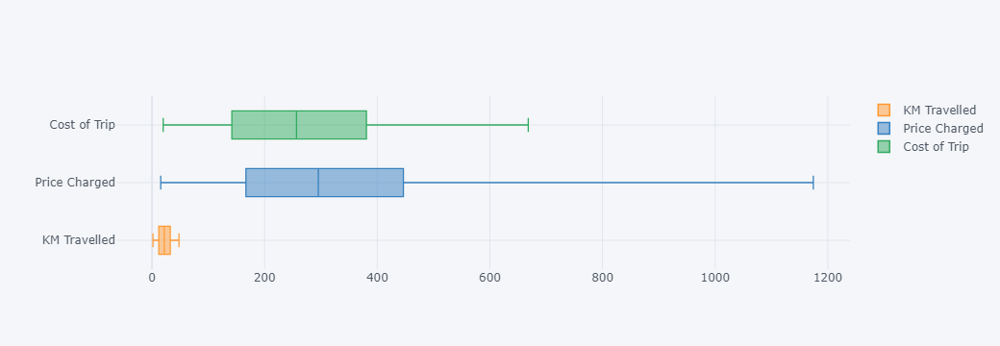

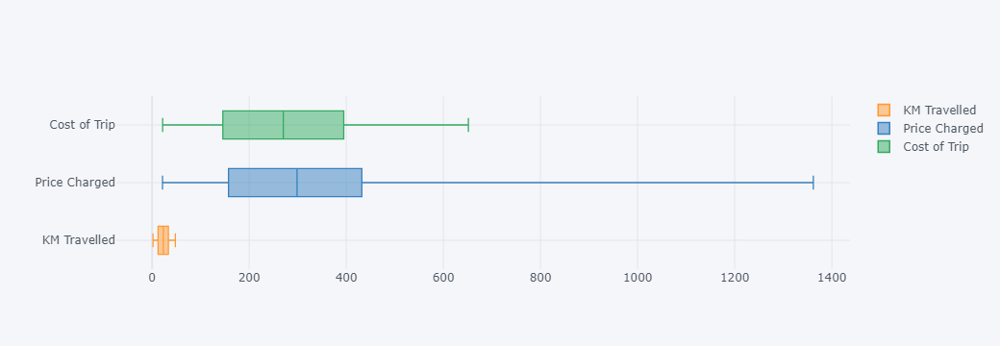

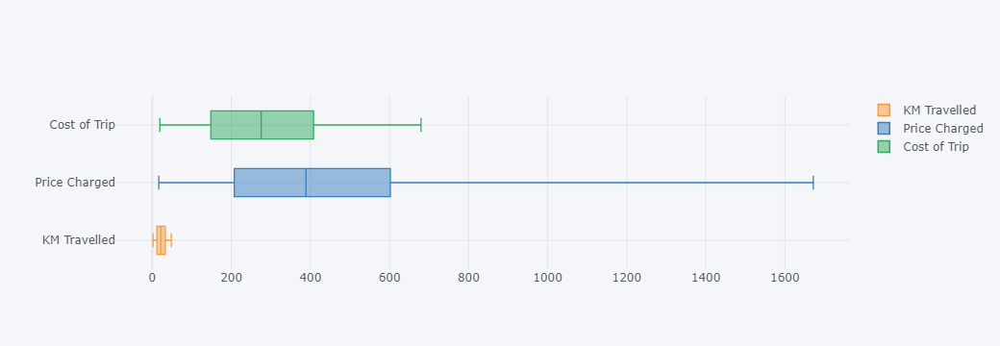

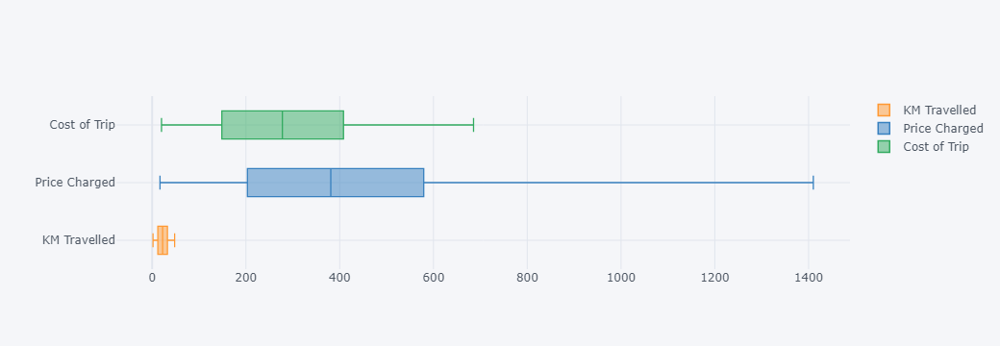

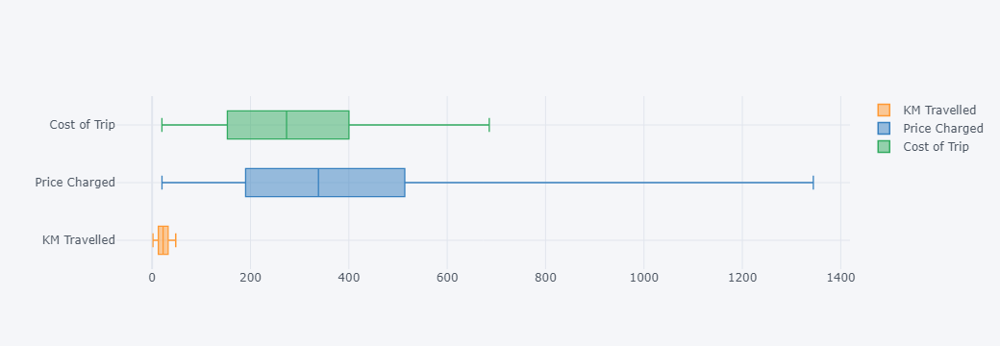

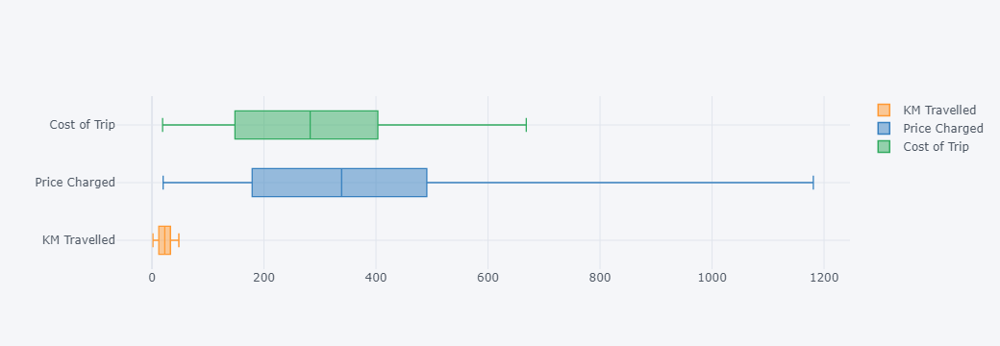

<Figure size 2000x1000 with 0 Axes>

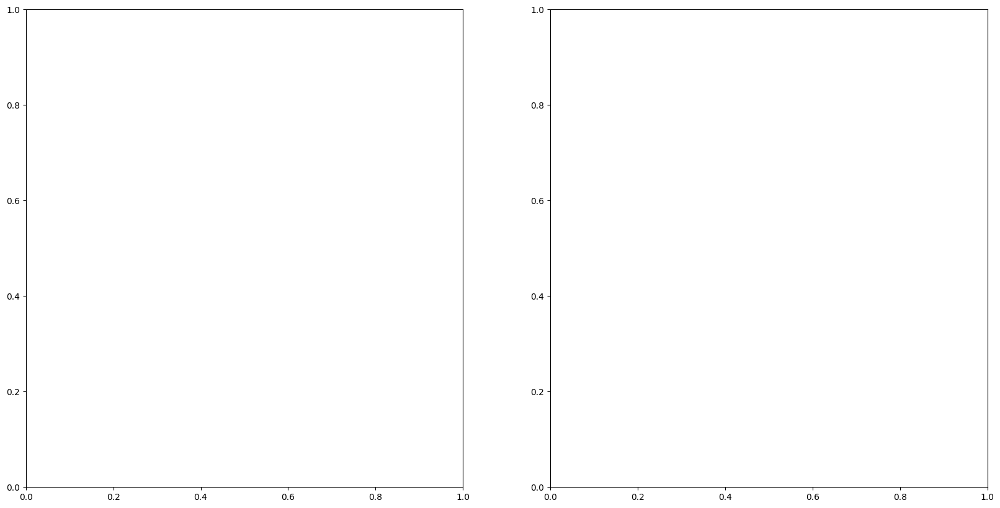

<Figure size 2000x1000 with 0 Axes>

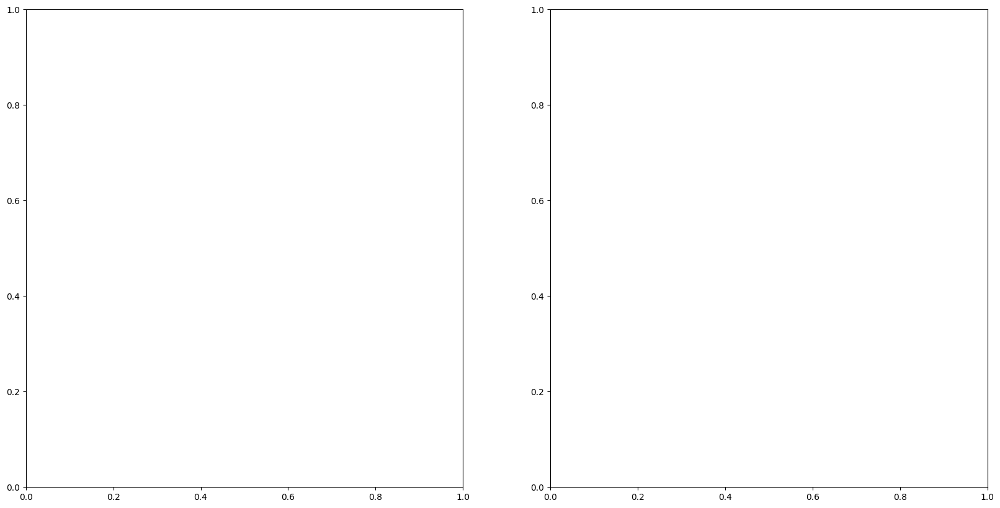

<Figure size 2000x1000 with 0 Axes>

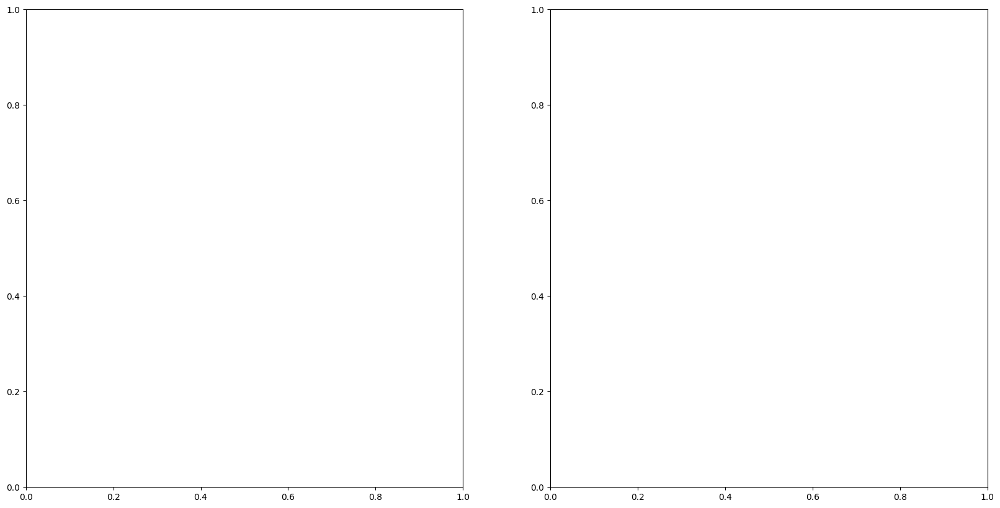

<Figure size 2000x1000 with 0 Axes>

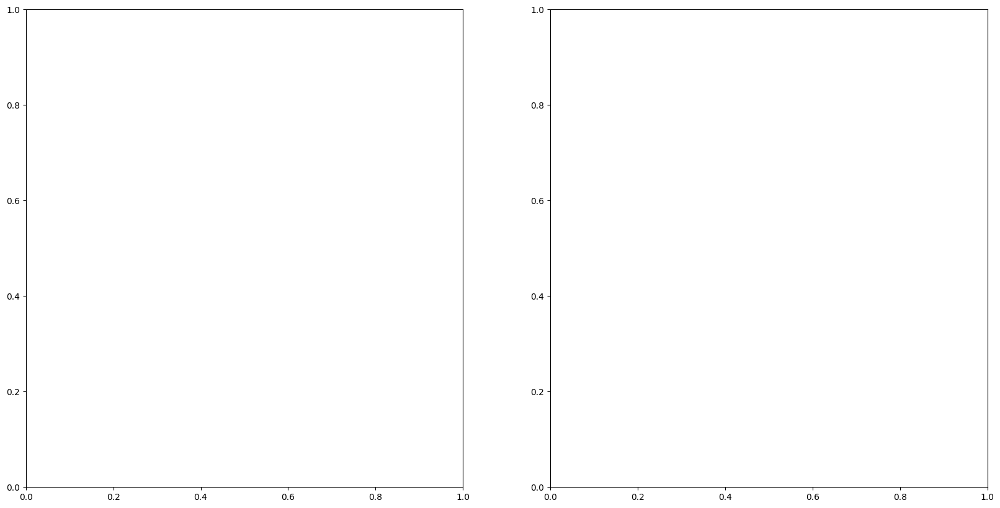

<Figure size 2000x1000 with 0 Axes>

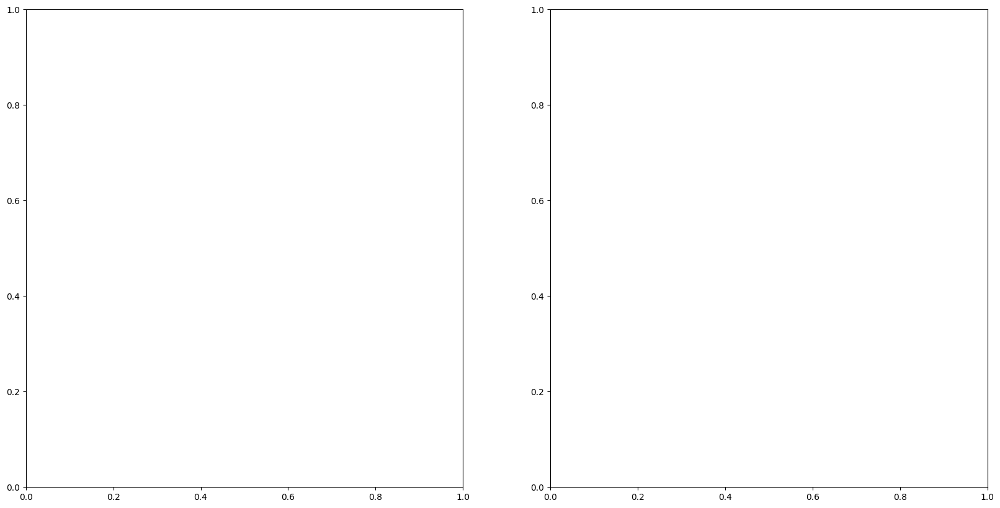

<Figure size 2000x1000 with 0 Axes>

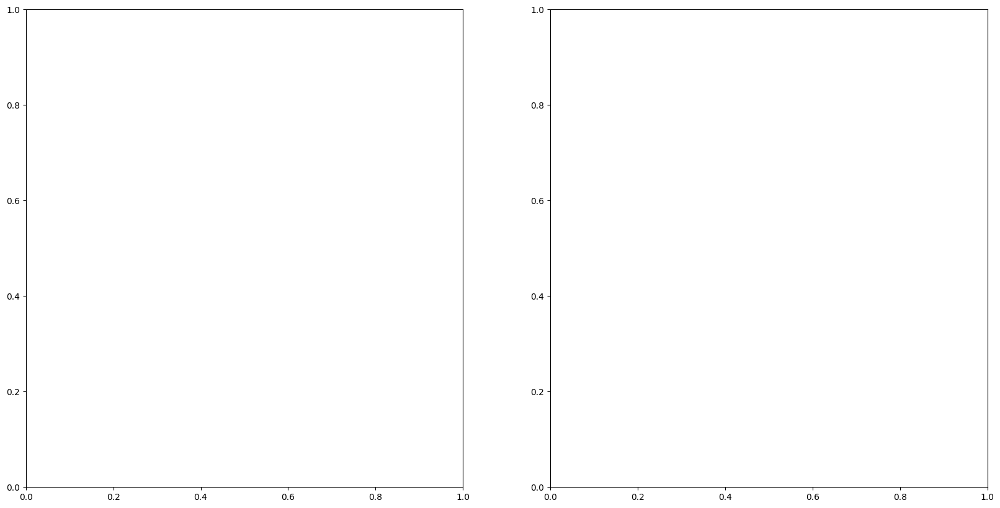

<Figure size 2000x1000 with 0 Axes>

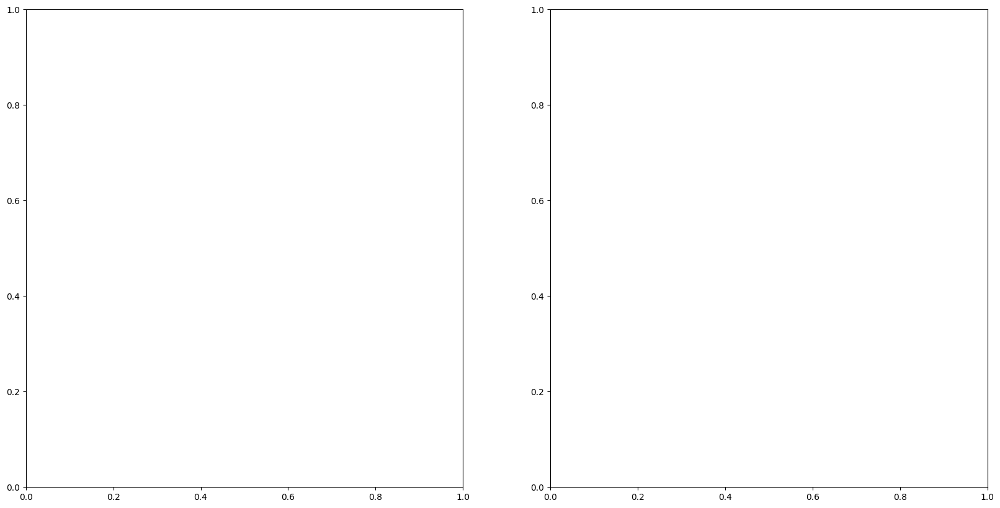

<Figure size 2000x1000 with 0 Axes>

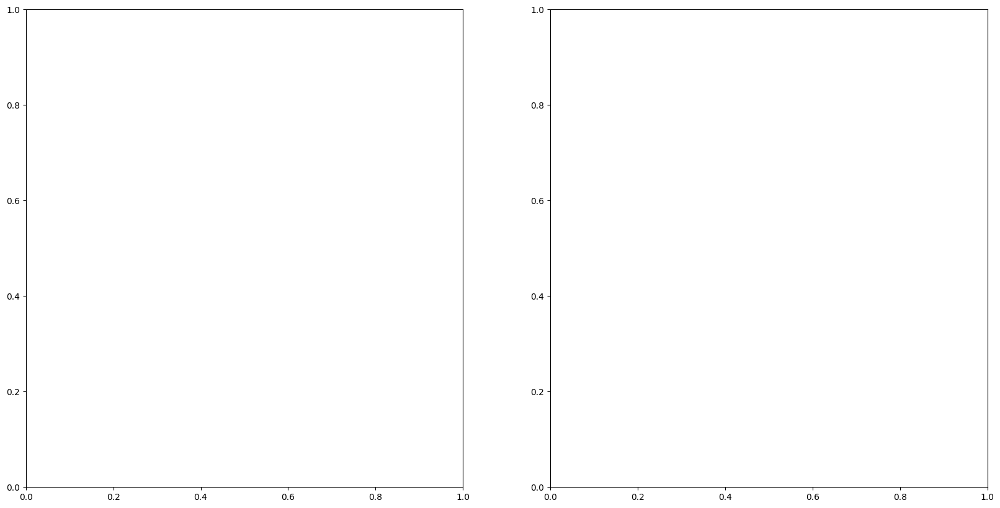

<Figure size 2000x1000 with 0 Axes>

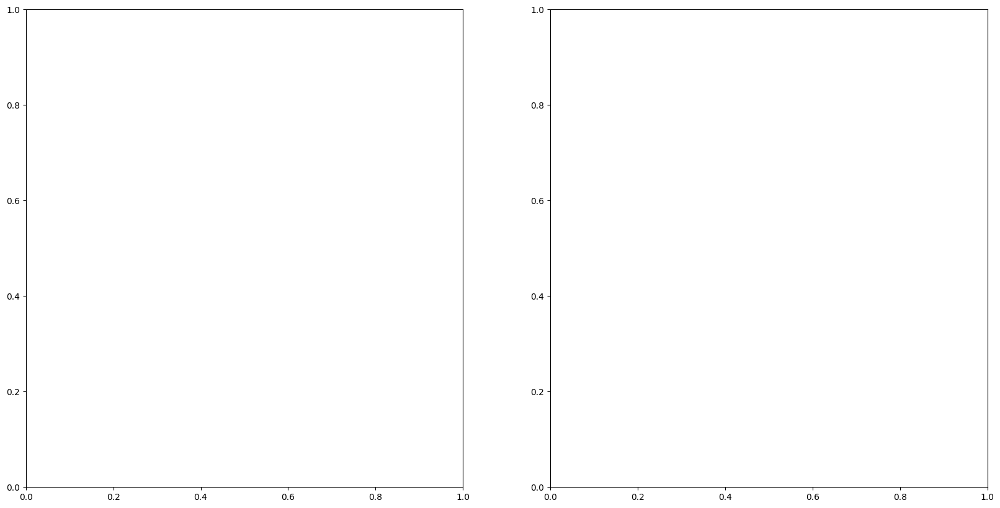

<Figure size 2000x1000 with 0 Axes>

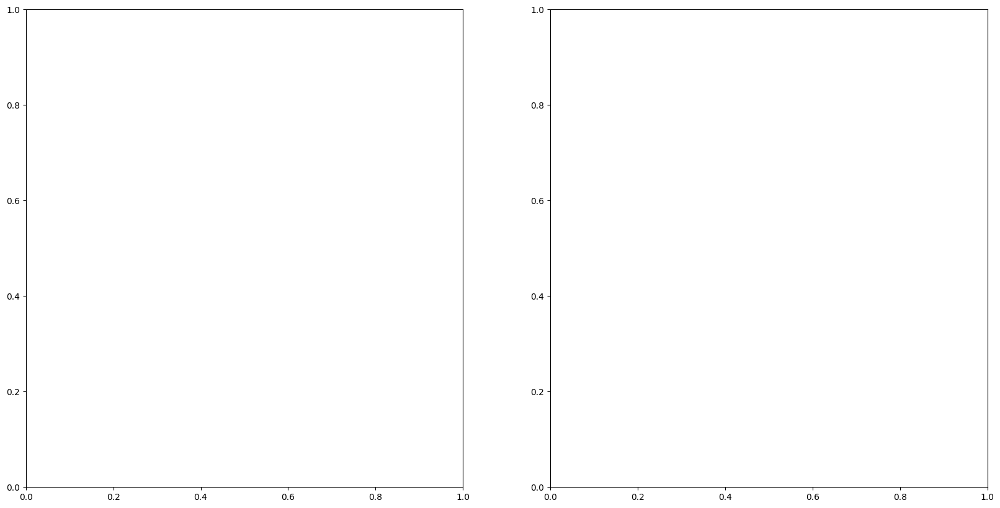

<Figure size 2000x1000 with 0 Axes>

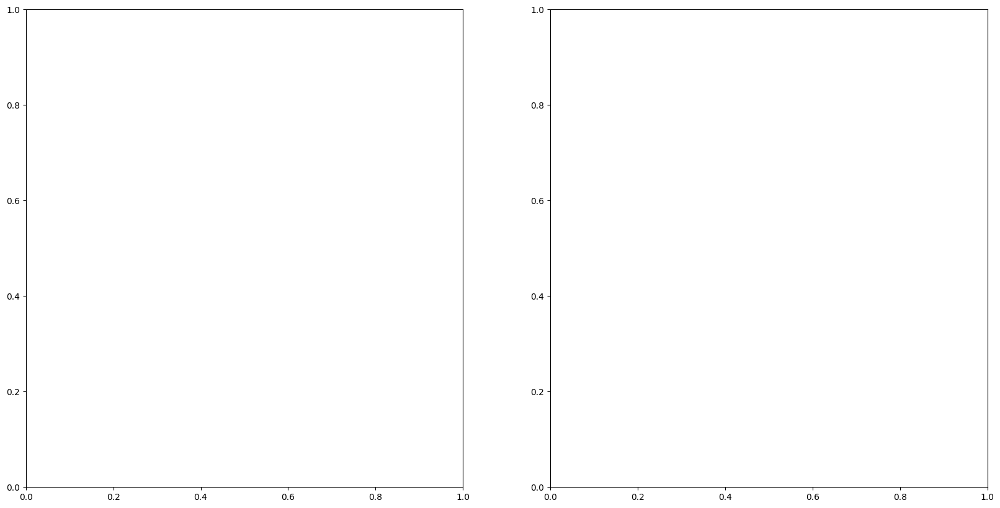

<Figure size 2000x1000 with 0 Axes>

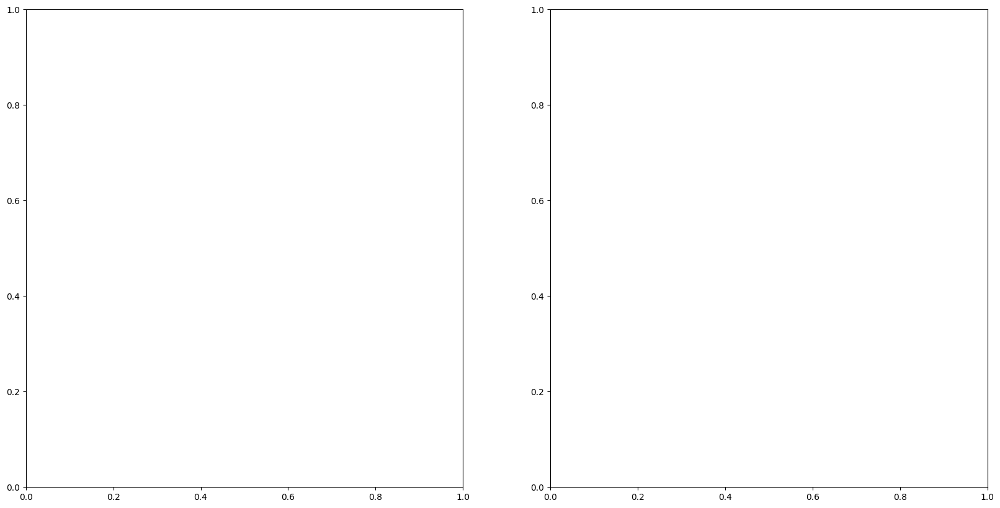

<Figure size 2000x1000 with 0 Axes>

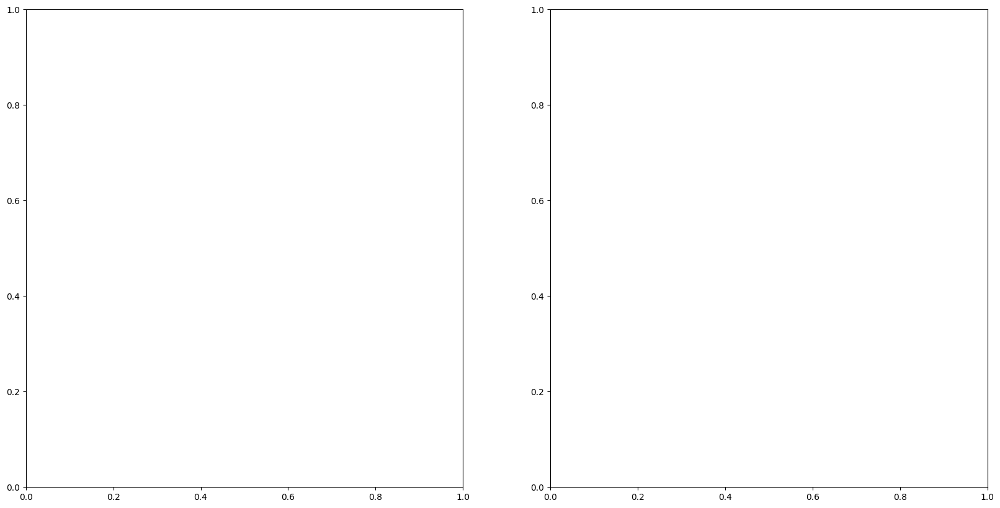

In [39]:
for state in group_state.groups:
    df = cab[cab["State"] == state].drop(columns=['Transaction ID', "Month", "Year", "Week Day", "Date of Travel", "Is Weekend", "Company", "City_State", "City", "State", "Day Name"])
    df1 = df[df['Date'].dt.year <=2017].drop(columns=['Date'])
    df2 = df[df['Date'].dt.year >2017].drop(columns=['Date'])
    plt.figure(figsize=(20,10))
    f, axes = plt.subplots(1, 2, figsize=(20,10))
    
    axes[0] = df1.iplot(kind='box', orientation='h')
    axes[1] = df2.iplot(kind='box', orientation='h')


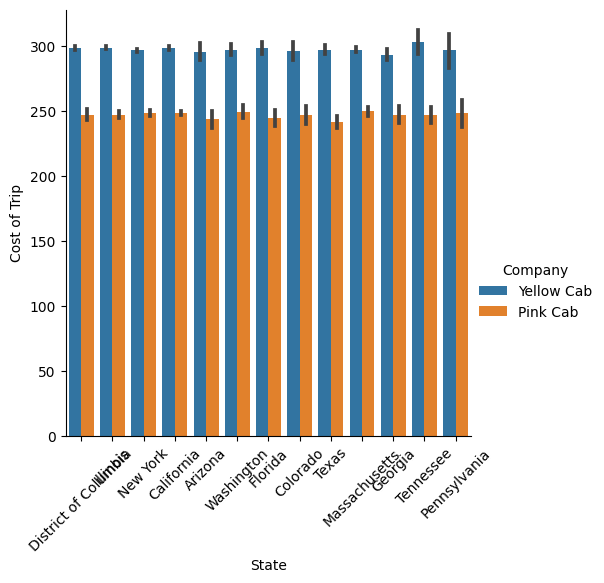

In [40]:
sns.catplot(x="State", y="Cost of Trip", hue="Company", kind="bar", data=cab)
plt.xticks(rotation=45)
plt.show()

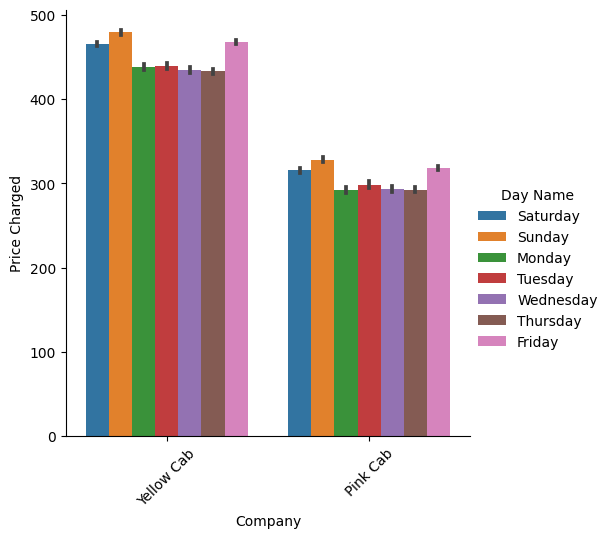

In [41]:
sns.catplot(x="Company", y="Price Charged", hue="Day Name", kind="bar", data=cab)
plt.xticks(rotation=45)
plt.show()

<AxesSubplot:xlabel='Date', ylabel='Price Charged'>

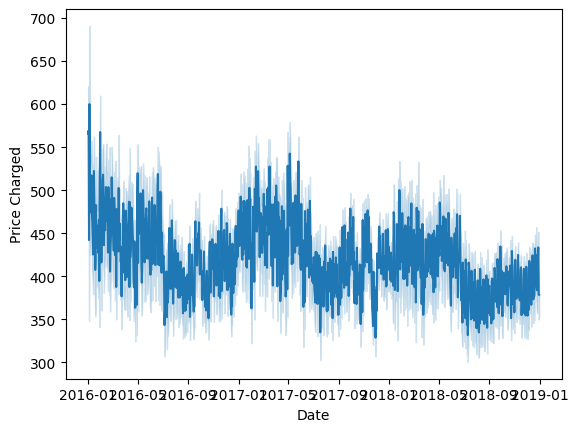

In [42]:
sns.lineplot(data=cab, x="Date", y="Price Charged")

<AxesSubplot:xlabel='Price Charged'>

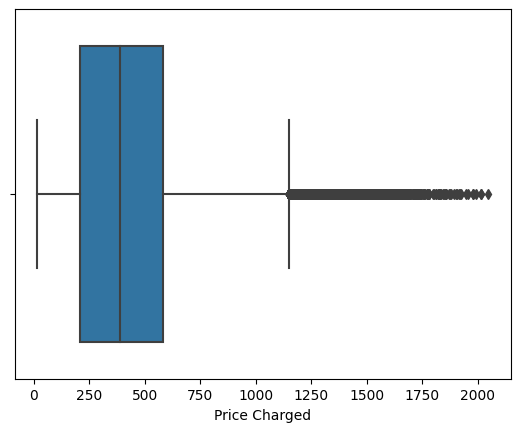

In [43]:
sns.boxplot(x=cab["Price Charged"])

In [44]:
cab['City'].value_counts()

NEW YORK          99885
CHICAGO           56625
LOS ANGELES       48033
WASHINGTON        43737
BOSTON            29692
SAN DIEGO         20488
SILICON VALLEY     8519
SEATTLE            7997
ATLANTA            7557
DALLAS             7017
MIAMI              6454
AUSTIN             4896
ORANGE COUNTY      3982
DENVER             3825
NASHVILLE          3010
SACRAMENTO         2367
PHOENIX            2064
TUCSON             1931
PITTSBURGH         1313
Name: City, dtype: int64

## City Exploration

In [45]:
print("city: ", city.shape)

city:  (20, 3)


In [46]:
city.head()

,City,Population,Users
0,NEW YORK NY,"8,405,837","302,149"
1,CHICAGO IL,"1,955,130","164,468"
2,LOS ANGELES CA,"1,595,037","144,132"
3,MIAMI FL,"1,339,155","17,675"
4,SILICON VALLEY,"1,177,609","27,247"


In [47]:
city.dtypes

City          object
Population    object
Users         object
dtype: object

In [48]:
city.isna().sum()

City          0
Population    0
Users         0
dtype: int64

In [49]:
def remove_comma(v):
    res = v.replace(',', '')
    return res

city['Population'] = city['Population'].apply(remove_comma)
city['Users'] = city['Users'].apply(remove_comma)

In [50]:
city['Population'] = city['Population'].astype('Int64')
city['Users'] = city['Users'].astype('Int64')

In [51]:
# difference between population and users 
city['Diff_pop_users'] = city['Population'] - city['Users']

In [52]:
# percent of users from population
city['Percent_of_users_from_pop'] =  (city['Users']/city['Population'])*100

In [174]:
city.head()

,City,Population,Users,Diff_pop_users,Percent_of_users_from_pop
0,NEW YORK NY,8405837,302149,8103688,3.594514
1,CHICAGO IL,1955130,164468,1790662,8.412126
2,LOS ANGELES CA,1595037,144132,1450905,9.036279
3,MIAMI FL,1339155,17675,1321480,1.319862
4,SILICON VALLEY,1177609,27247,1150362,2.313756


In [54]:
city.sort_values(by='Percent_of_users_from_pop', ascending=False)

,City,Population,Users,Diff_pop_users,Percent_of_users_from_pop
14,SAN FRANCISCO CA,629591,213609,415982,33.928217
19,BOSTON MA,248968,80021,168947,32.141078
17,WASHINGTON DC,418859,127001,291858,30.320705
2,LOS ANGELES CA,1595037,144132,1450905,9.036279
1,CHICAGO IL,1955130,164468,1790662,8.412126
6,SAN DIEGO CA,959307,69995,889312,7.296413
12,SEATTLE WA,671238,25063,646175,3.733847
0,NEW YORK NY,8405837,302149,8103688,3.594514
9,ATLANTA GA,814885,24701,790184,3.031225
18,NASHVILLE TN,327225,9270,317955,2.832913


In [178]:
city["Users"].sum()

1290413

In [177]:
city.to_csv("DataSets-main/City_clean.csv", index=False)

## Customer exploration

In [55]:
print("customer: ", customer.shape)

customer:  (49171, 4)


In [56]:
customer.head()

,Customer ID,Gender,Age,Income (USD/Month)
0,29290,Male,28,10813
1,27703,Male,27,9237
2,28712,Male,53,11242
3,28020,Male,23,23327
4,27182,Male,33,8536


In [57]:
customer.dtypes

Customer ID            int64
Gender                object
Age                    int64
Income (USD/Month)     int64
dtype: object

In [58]:
customer.describe()

,Customer ID,Age,Income (USD/Month)
count,49171.000000,49171.000000,49171.000000
mean,28398.252283,35.363121,15015.631856
std,17714.137333,12.599066,8002.208253
min,1.000000,18.000000,2000.000000
25%,12654.500000,25.000000,8289.500000
50%,27631.000000,33.000000,14656.000000
75%,43284.500000,42.000000,21035.000000
max,60000.000000,65.000000,35000.000000


In [59]:
customer['Gender'].value_counts(normalize=True)

Male      0.540196
Female    0.459804
Name: Gender, dtype: float64

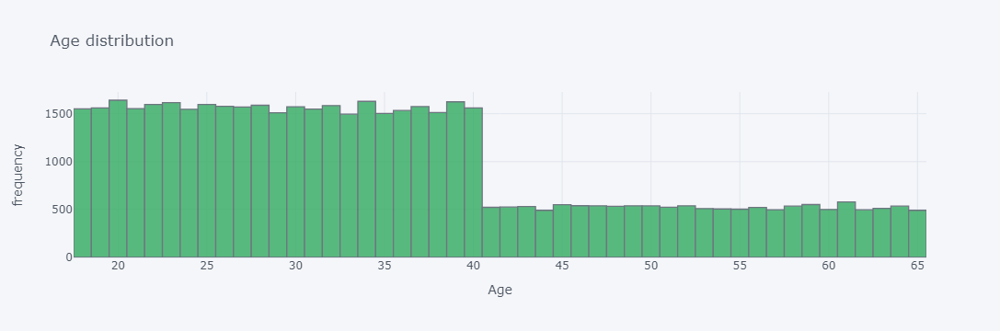

In [60]:
customer.iplot(kind='hist',column='Age', title="Age distribution", xTitle="Age", yTitle='frequency')

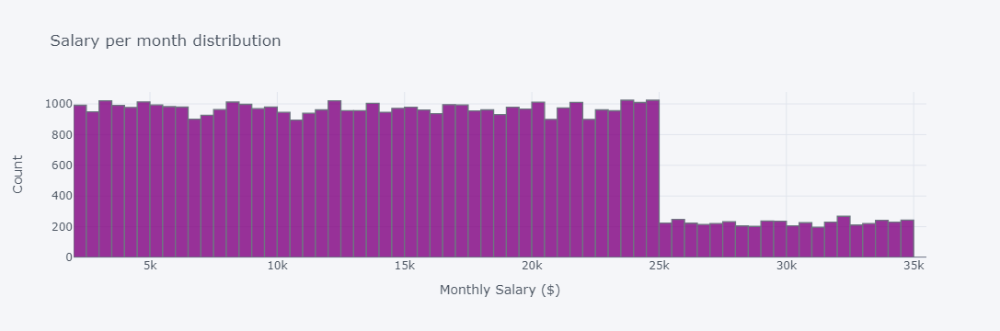

In [61]:
customer.iplot(kind='hist', column='Income (USD/Month)', title="Salary per month distribution", xTitle="Monthly Salary ($)", yTitle="Count", mean=True)

In [62]:
customer.corr()

,Customer ID,Age,Income (USD/Month)
Customer ID,1.000000,-0.006749,-0.006911
Age,-0.006749,1.000000,0.000156
Income (USD/Month),-0.006911,0.000156,1.000000


In [63]:
profile = customer.profile_report(title="Customer Data")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [64]:
customer.isna().sum()

Customer ID           0
Gender                0
Age                   0
Income (USD/Month)    0
dtype: int64

In [67]:
print(customer["Age"].min())
print(customer["Age"].max())

18
65


In [68]:
def get_num_people_by_age_category(df):
    df["age_group"] = pd.cut(x=df['Age'], bins=[17,25,35,45,66], labels=["18-25","26-35","36-45","46-65"])
    return df

In [69]:
new_customer = get_num_people_by_age_category(customer)

In [70]:
new_customer[new_customer['Age'] ==18]

,Customer ID,Gender,Age,Income (USD/Month),age_group
25,4004,Male,18,3896,18-25
65,7409,Male,18,7182,18-25
121,11224,Male,18,2913,18-25
127,2060,Male,18,8149,18-25
131,2626,Male,18,30401,18-25
159,20206,Male,18,24295,18-25
221,43988,Male,18,5299,18-25
394,33730,Male,18,18347,18-25
406,59419,Male,18,12819,18-25
442,59824,Male,18,7809,18-25


In [71]:
new_customer.isna().sum()

Customer ID           0
Gender                0
Age                   0
Income (USD/Month)    0
age_group             0
dtype: int64

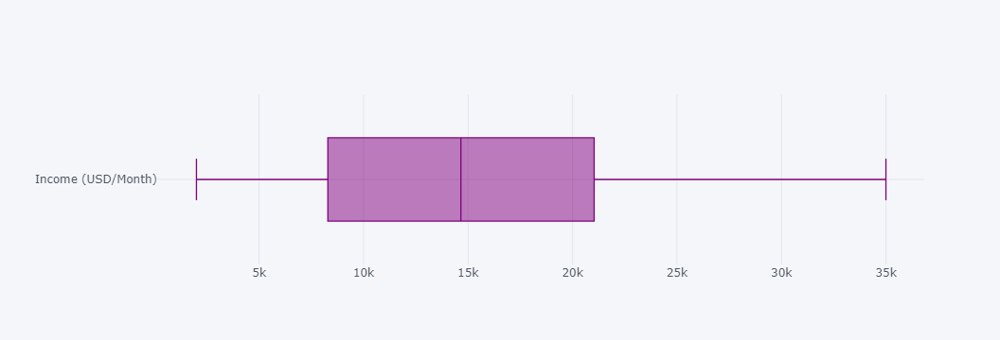

In [72]:
new_customer.iplot( kind='box',column='Income (USD/Month)', orientation='h')

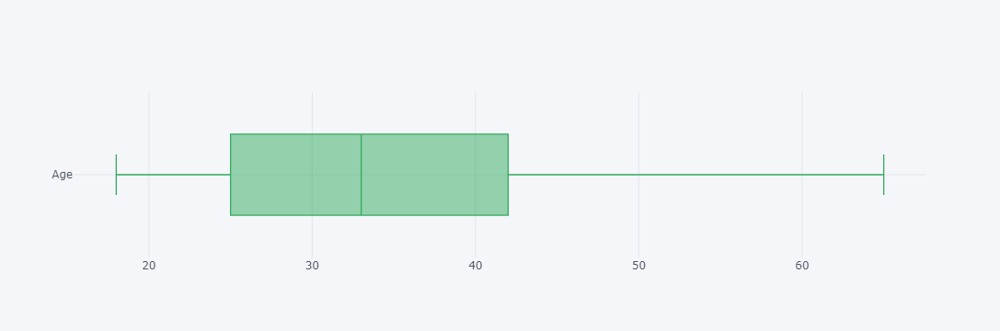

In [73]:
new_customer.iplot( kind='box',column='Age', orientation='h')

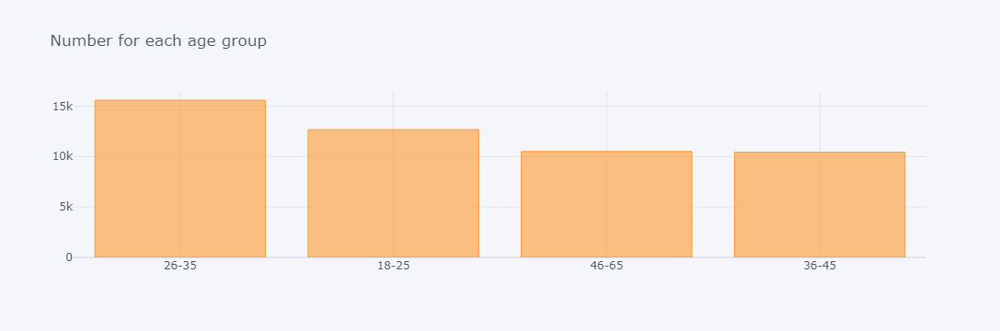

In [74]:
new_customer['age_group'].value_counts().iplot(kind='bar',title="Number for each age group")


In [179]:
new_customer.to_csv("DataSets-main/customer_clean.csv", index=False)

## Transaction exploration

In [75]:
print("transaction: ", trans.shape)

transaction:  (440098, 3)


In [76]:
trans.head()

,Transaction ID,Customer ID,Payment_Mode
0,10000011,29290,Card
1,10000012,27703,Card
2,10000013,28712,Cash
3,10000014,28020,Cash
4,10000015,27182,Card


In [77]:
len(trans["Customer ID"].unique())

49171

In [78]:
len(new_customer["Customer ID"].unique())

49171

In [79]:
len(trans["Transaction ID"].unique())

440098

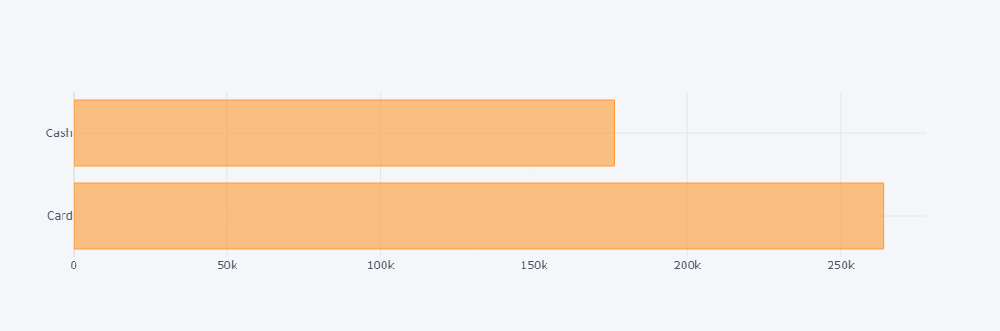

In [80]:
trans['Payment_Mode'].value_counts().iplot(kind='bar', orientation='h')

In [81]:
cust_trans = pd.merge(new_customer, trans, on="Customer ID")

In [82]:
cust_trans.head()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode
0,29290,Male,28,10813,26-35,10000011,Card
1,29290,Male,28,10813,26-35,10351127,Cash
2,29290,Male,28,10813,26-35,10412921,Card
3,27703,Male,27,9237,26-35,10000012,Card
4,27703,Male,27,9237,26-35,10320494,Card


In [83]:
len(cust_trans['Transaction ID'].unique())

440098

In [84]:
cust_trans.isna().sum()

Customer ID           0
Gender                0
Age                   0
Income (USD/Month)    0
age_group             0
Transaction ID        0
Payment_Mode          0
dtype: int64

In [85]:
len(cab['Transaction ID'].unique())

359392

In [86]:
cab.columns

Index(['Transaction ID', 'Date of Travel', 'Company', 'City_State',
       'KM Travelled', 'Price Charged', 'Cost of Trip', 'Date', 'City',
       'State', 'Day Name', 'Month', 'Year', 'Week Day', 'Is Weekend'],
      dtype='object')

In [87]:
cab_cust_trans = pd.merge(cust_trans, cab, on='Transaction ID')

In [88]:
cab_cust_trans.head()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend
0,29290,Male,28,10813,26-35,10000011,Card,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,2016-01-08,ATLANTA,Georgia,Friday,1,2016,4,False
1,29290,Male,28,10813,26-35,10351127,Cash,43302,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,2018-07-21,ATLANTA,Georgia,Saturday,7,2018,5,True
2,29290,Male,28,10813,26-35,10412921,Card,43427,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,2018-11-23,ATLANTA,Georgia,Friday,11,2018,4,False
3,27703,Male,27,9237,26-35,10000012,Card,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,2016-01-06,ATLANTA,Georgia,Wednesday,1,2016,2,False
4,27703,Male,27,9237,26-35,10320494,Card,43211,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,2018-04-21,ATLANTA,Georgia,Saturday,4,2018,5,True


In [89]:
cab_cust_trans.tail()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend
359387,38520,Female,42,19417,36-45,10439790,Card,43107,Yellow Cab,SEATTLE WA,16.66,261.18,213.9144,2018-01-07,SEATTLE,Washington,Sunday,1,2018,6,True
359388,12490,Male,33,18713,26-35,10439799,Cash,43103,Yellow Cab,SILICON VALLEY,13.72,277.97,172.8720,2018-01-03,SILICON VALLEY,California,Wednesday,1,2018,2,False
359389,41414,Male,38,3960,36-45,10439838,Card,43104,Yellow Cab,TUCSON AZ,19.00,303.77,232.5600,2018-01-04,TUCSON,Arizona,Thursday,1,2018,3,False
359390,41677,Male,23,19454,18-25,10439840,Cash,43106,Yellow Cab,TUCSON AZ,5.60,92.42,70.5600,2018-01-06,TUCSON,Arizona,Saturday,1,2018,5,True
359391,39761,Female,32,10128,26-35,10439846,Card,43104,Yellow Cab,TUCSON AZ,13.30,244.65,180.3480,2018-01-04,TUCSON,Arizona,Thursday,1,2018,3,False


In [90]:
cab_cust_trans.isna().sum()

Customer ID           0
Gender                0
Age                   0
Income (USD/Month)    0
age_group             0
Transaction ID        0
Payment_Mode          0
Date of Travel        0
Company               0
City_State            0
KM Travelled          0
Price Charged         0
Cost of Trip          0
Date                  0
City                  0
State                 0
Day Name              0
Month                 0
Year                  0
Week Day              0
Is Weekend            0
dtype: int64

In [91]:
len(cab_cust_trans['Transaction ID'].unique())

359392

In [92]:
cab_cust_trans.dtypes

Customer ID                    int64
Gender                        object
Age                            int64
Income (USD/Month)             int64
age_group                   category
Transaction ID                 int64
Payment_Mode                  object
Date of Travel                 int64
Company                       object
City_State                    object
KM Travelled                 float64
Price Charged                float64
Cost of Trip                 float64
Date                  datetime64[ns]
City                          object
State                         object
Day Name                      object
Month                          int64
Year                           int64
Week Day                       int64
Is Weekend                      bool
dtype: object

In [93]:
cab_cust_trans[cab_cust_trans.duplicated()]

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend


## Weather

#### weather datset from 2017 t0 2018, containing all cities besides Silicon Valley, Orange County, Atlanta, Pittsburgh

In [94]:
weather = pd.read_csv("DataSets-main/weather_2017_2018.csv", low_memory=False,parse_dates=True)

In [95]:
weather.shape

(289810, 28)

In [96]:
weather['Name'].head()

0    Akron, OH, United States
1    Akron, OH, United States
2    Akron, OH, United States
3    Akron, OH, United States
4    Akron, OH, United States
Name: Name, dtype: object

In [97]:
weather[['City', 'State', 'Country']] = weather['Name'].str.split(', ', expand=True)

In [98]:
weather.shape

(289810, 31)

In [99]:
weather.dtypes

Name                    object
Wind Direction         float64
Latitude               float64
Cloud Cover            float64
Minimum Temperature    float64
Date time               object
Precipitation          float64
Solar Radiation        float64
Dew Point              float64
Relative Humidity      float64
ID                      object
Precipitation Cover    float64
Longitude              float64
Info                   float64
Temperature            float64
Maximum Temperature    float64
Visibility             float64
Wind Speed             float64
Solar Energy           float64
Heat Index             float64
Weather Type            object
Snow Depth             float64
Sea Level Pressure     float64
Snow                   float64
Name.1                  object
Wind Gust              float64
Conditions              object
Wind Chill             float64
City                    object
State                   object
Country                 object
dtype: object

In [100]:
weather['Date'] = pd.to_datetime(weather['Date time'], infer_datetime_format=True, errors='coerce', format ='%m/%d/%Y')

In [101]:
weather['City'] = weather['City'].str.upper()

In [102]:
filter_list = ['NEW YORK','CHICAGO','LOS ANGELES','WASHINGTON','BOSTON','SAN DIEGO','SEATTLE','DALLAS'
'MIAMI','AUSTIN','DENVER','NASHVILLE','SACRAMENTO','PHOENIX','TUCSON','PITTSBURGH']
filt_weather = weather[weather['City'].isin(filter_list)]

In [103]:
filt_weather['State'].unique()

array(['TX', 'MA', 'IL', 'CO', 'CA', 'TN', 'NY', 'AZ', 'WA', 'DC', 'NC'],
      dtype=object)

In [104]:
filt_weather[filt_weather['City'] == "WASHINGTON"]['State'].unique()

array(['DC', 'NC'], dtype=object)

In [105]:
filt_weather = filt_weather[~(filt_weather['State'] == 'NC')]

In [106]:
filt_weather['State'].unique()

array(['TX', 'MA', 'IL', 'CO', 'CA', 'TN', 'NY', 'AZ', 'WA', 'DC'],
      dtype=object)

In [107]:
filt_weather.head()

,Name,Wind Direction,Latitude,Cloud Cover,Minimum Temperature,Date time,Precipitation,Solar Radiation,Dew Point,Relative Humidity,ID,Precipitation Cover,Longitude,Info,Temperature,Maximum Temperature,Visibility,Wind Speed,Solar Energy,Heat Index,Weather Type,Snow Depth,Sea Level Pressure,Snow,Name.1,Wind Gust,Conditions,Wind Chill,City,State,Country,Date
17520,"Austin, TX, United States",108.54,30.26759,26.9,52.5,01/01/2017,0.00,NaN,51.0,70.77,'Austin TX',0.00,-97.74299,NaN,61.6,74.4,8.0,6.8,NaN,NaN,"Mist, Fog, Smoke Or Haze",0.0,1010.5,0.0,"Austin, TX, United States",NaN,Partially cloudy,NaN,AUSTIN,TX,United States,2017-01-01
17521,"Austin, TX, United States",256.71,30.26759,31.8,54.0,01/02/2017,0.32,NaN,51.9,71.10,'Austin TX',20.83,-97.74299,NaN,63.0,73.7,8.2,14.4,NaN,NaN,"Mist, Light Drizzle, Rain, Thunderstorm, Fog, ...",0.0,1011.1,0.0,"Austin, TX, United States",25.0,"Rain, Partially cloudy",NaN,AUSTIN,TX,United States,2017-01-02
17522,"Austin, TX, United States",227.58,30.26759,12.3,45.8,01/03/2017,0.00,NaN,39.8,53.37,'Austin TX',0.00,-97.74299,NaN,58.6,75.3,9.9,11.5,NaN,NaN,NaN,0.0,1016.7,0.0,"Austin, TX, United States",23.0,Clear,40.9,AUSTIN,TX,United States,2017-01-03
17523,"Austin, TX, United States",206.71,30.26759,43.5,38.4,01/04/2017,0.00,NaN,28.4,58.34,'Austin TX',0.00,-97.74299,NaN,42.2,47.7,9.9,11.7,NaN,NaN,NaN,0.0,1020.4,0.0,"Austin, TX, United States",19.7,Partially cloudy,31.5,AUSTIN,TX,United States,2017-01-04
17524,"Austin, TX, United States",120.83,30.26759,83.1,36.4,01/05/2017,0.00,NaN,35.9,64.25,'Austin TX',0.00,-97.74299,NaN,47.6,62.1,9.8,16.0,NaN,NaN,Smoke Or Haze,0.0,1014.1,0.0,"Austin, TX, United States",27.6,Overcast,28.1,AUSTIN,TX,United States,2017-01-05


In [108]:
clean_weather = filt_weather[["City", "Date","Latitude", "Longitude", "Temperature", "Cloud Cover", "Precipitation", "Relative Humidity", "Wind Speed", "Snow Depth", "Snow", "Conditions"]]
clean_weather.head()

,City,Date,Latitude,Longitude,Temperature,Cloud Cover,Precipitation,Relative Humidity,Wind Speed,Snow Depth,Snow,Conditions
17520,AUSTIN,2017-01-01,30.26759,-97.74299,61.6,26.9,0.00,70.77,6.8,0.0,0.0,Partially cloudy
17521,AUSTIN,2017-01-02,30.26759,-97.74299,63.0,31.8,0.32,71.10,14.4,0.0,0.0,"Rain, Partially cloudy"
17522,AUSTIN,2017-01-03,30.26759,-97.74299,58.6,12.3,0.00,53.37,11.5,0.0,0.0,Clear
17523,AUSTIN,2017-01-04,30.26759,-97.74299,42.2,43.5,0.00,58.34,11.7,0.0,0.0,Partially cloudy
17524,AUSTIN,2017-01-05,30.26759,-97.74299,47.6,83.1,0.00,64.25,16.0,0.0,0.0,Overcast


In [109]:
def fahr_to_cels(fahr):
    cels = round((fahr - 32.0) * 5.0/9.0, 1); #Fahr to cels
    return cels

def inch_to_mm(inch):
    mm = round(inch*25.4); #inch to mm
    return mm

def miles_to_km(miles):
    km = round(miles*1.6); #miles to km
    return km

In [110]:
clean_weather["Temperature"] = clean_weather["Temperature"].apply(fahr_to_cels)
clean_weather["Wind Speed"] = clean_weather["Wind Speed"].apply(miles_to_km)
clean_weather["Precipitation"] = clean_weather["Precipitation"].apply(inch_to_mm)
clean_weather["Snow"] = clean_weather["Snow"].apply(inch_to_mm)
clean_weather["Snow Depth"] = clean_weather["Snow Depth"].apply(inch_to_mm)

In [111]:
print(clean_weather.shape)
clean_weather.head()

(9490, 12)


,City,Date,Latitude,Longitude,Temperature,Cloud Cover,Precipitation,Relative Humidity,Wind Speed,Snow Depth,Snow,Conditions
17520,AUSTIN,2017-01-01,30.26759,-97.74299,16.4,26.9,0,70.77,11,0,0,Partially cloudy
17521,AUSTIN,2017-01-02,30.26759,-97.74299,17.2,31.8,8,71.10,23,0,0,"Rain, Partially cloudy"
17522,AUSTIN,2017-01-03,30.26759,-97.74299,14.8,12.3,0,53.37,18,0,0,Clear
17523,AUSTIN,2017-01-04,30.26759,-97.74299,5.7,43.5,0,58.34,19,0,0,Partially cloudy
17524,AUSTIN,2017-01-05,30.26759,-97.74299,8.7,83.1,0,64.25,26,0,0,Overcast


In [112]:
clean_weather.isna().sum()

City                 0
Date                 0
Latitude             0
Longitude            0
Temperature          0
Cloud Cover          0
Precipitation        0
Relative Humidity    0
Wind Speed           0
Snow Depth           0
Snow                 0
Conditions           0
dtype: int64

In [113]:
clean_weather.rename(columns={'Temperature': 'Temperature C', 'Cloud Cover': 'Cloud Cover %', 'Precipitation': 'Precipitation mm', 'Relative Humidity': 'Humidity %', 'Wind Speed': 'Wind Speed km', 'Snow Depth': 'Snow Depth mm', 'Snow': 'Snow mm'}, inplace=True)

In [114]:
clean_weather.columns

Index(['City', 'Date', 'Latitude', 'Longitude', 'Temperature C',
       'Cloud Cover %', 'Precipitation mm', 'Humidity %', 'Wind Speed km',
       'Snow Depth mm', 'Snow mm', 'Conditions'],
      dtype='object')

In [115]:
clean_weather['Date'].min()

Timestamp('2017-01-01 00:00:00')

In [116]:
clean_weather['Date'].max()

Timestamp('2018-12-31 00:00:00')

In [117]:
clean_weather['City'].unique()

array(['AUSTIN', 'BOSTON', 'CHICAGO', 'DENVER', 'LOS ANGELES',
       'NASHVILLE', 'NEW YORK', 'PHOENIX', 'SACRAMENTO', 'SAN DIEGO',
       'SEATTLE', 'TUCSON', 'WASHINGTON'], dtype=object)

In [118]:
clean_weather[clean_weather.duplicated()]

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions


#### Weather dataset for 2016, containing all cities required

In [119]:
weather2 = pd.read_csv("DataSets-main/weather_2016.csv", parse_dates=True)

In [120]:
weather2.head()

,name,latitude,longitude,datetime,tempmax,tempmin,temp,dew,humidity,precip,precipcover,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,conditions,description
0,NASHVILLE,36.168,-86.778,2016-01-01,6.6,0.2,2.5,-4.0,62.8,0.0,0.0,0.0,0.0,32.6,13.2,330.4,1028.7,60.7,16.0,86.5,7.5,4,Partially cloudy,Partly cloudy throughout the day.
1,NASHVILLE,36.168,-86.778,2016-01-02,9.9,-4.4,2.5,-5.5,60.0,0.0,0.0,0.0,0.0,NaN,13.0,242.0,1025.8,24.5,15.9,140.8,12.2,6,Partially cloudy,Partly cloudy throughout the day.
2,NASHVILLE,36.168,-86.778,2016-01-03,11.7,-1.4,4.0,-4.1,58.4,0.0,0.0,0.0,0.0,35.3,25.4,289.2,1020.8,29.5,16.0,134.9,11.7,5,Partially cloudy,Partly cloudy throughout the day.
3,NASHVILLE,36.168,-86.778,2016-01-04,3.8,-2.7,0.8,-6.9,57.5,0.0,0.0,0.0,0.0,39.1,28.7,213.6,1028.3,65.3,16.0,138.9,12.2,6,Partially cloudy,Partly cloudy throughout the day.
4,NASHVILLE,36.168,-86.778,2016-01-05,6.3,-4.0,0.3,-8.3,55.1,0.0,0.0,0.0,0.0,NaN,16.5,69.4,1032.8,30.5,16.0,132.1,11.5,6,Partially cloudy,Partly cloudy throughout the day.


In [121]:
weather2.dtypes

name                 object
latitude            float64
longitude           float64
datetime             object
tempmax             float64
tempmin             float64
temp                float64
dew                 float64
humidity            float64
precip              float64
precipcover         float64
snow                float64
snowdepth           float64
windgust            float64
windspeed           float64
winddir             float64
sealevelpressure    float64
cloudcover          float64
visibility          float64
solarradiation      float64
solarenergy         float64
uvindex               int64
conditions           object
description          object
dtype: object

In [122]:
weather2['Date'] = pd.to_datetime(weather2['datetime'], infer_datetime_format=True, errors='coerce', format ='%Y/%m/%d')

In [123]:
weather2['name'].unique()

array(['NASHVILLE', 'CHICAGO', 'NEW YORK', 'SEATTLE', 'WASHINGTON',
       'PITTSBURGH', 'TUCSON', 'LOS ANGELES', 'AUSTIN', 'DENVER',
       'PHOENIX', 'SAN DIEGO', 'DALLAS', 'SACRAMENTO', 'SILICON VALLEY',
       'MIAMI', 'ORANGE COUNTY', 'BOSTON', 'ATLANTA'], dtype=object)

In [124]:
weather2.shape

(6954, 25)

In [125]:
weather2.columns

Index(['name', 'latitude', 'longitude', 'datetime', 'tempmax', 'tempmin',
       'temp', 'dew', 'humidity', 'precip', 'precipcover', 'snow', 'snowdepth',
       'windgust', 'windspeed', 'winddir', 'sealevelpressure', 'cloudcover',
       'visibility', 'solarradiation', 'solarenergy', 'uvindex', 'conditions',
       'description', 'Date'],
      dtype='object')

In [126]:
weather_clean2 = weather2[["name", "Date", "latitude", "longitude", "temp", "cloudcover", "precip", "humidity", "windspeed","snowdepth", "snow", "conditions"]]
print(weather_clean2.shape)
weather_clean2.head()

(6954, 12)


,name,Date,latitude,longitude,temp,cloudcover,precip,humidity,windspeed,snowdepth,snow,conditions
0,NASHVILLE,2016-01-01,36.168,-86.778,2.5,60.7,0.0,62.8,13.2,0.0,0.0,Partially cloudy
1,NASHVILLE,2016-01-02,36.168,-86.778,2.5,24.5,0.0,60.0,13.0,0.0,0.0,Partially cloudy
2,NASHVILLE,2016-01-03,36.168,-86.778,4.0,29.5,0.0,58.4,25.4,0.0,0.0,Partially cloudy
3,NASHVILLE,2016-01-04,36.168,-86.778,0.8,65.3,0.0,57.5,28.7,0.0,0.0,Partially cloudy
4,NASHVILLE,2016-01-05,36.168,-86.778,0.3,30.5,0.0,55.1,16.5,0.0,0.0,Partially cloudy


In [127]:
weather_clean2.isna().sum()

name          0
Date          0
latitude      0
longitude     0
temp          0
cloudcover    0
precip        0
humidity      0
windspeed     0
snowdepth     0
snow          0
conditions    0
dtype: int64

In [128]:
weather_clean2.rename(columns={'name': 'City','latitude': 'Latitude', 'longitude': 'Longitude','temp': 'Temperature C', 'cloudcover': 'Cloud Cover %', 'precip': 'Precipitation mm', 'humidity': 'Humidity %', 'windspeed': 'Wind Speed km', 'snowdepth': 'Snow Depth mm', 'snow': 'Snow mm', 'conditions': 'Conditions'}, inplace=True)

In [129]:
weather_clean2.columns

Index(['City', 'Date', 'Latitude', 'Longitude', 'Temperature C',
       'Cloud Cover %', 'Precipitation mm', 'Humidity %', 'Wind Speed km',
       'Snow Depth mm', 'Snow mm', 'Conditions'],
      dtype='object')

In [130]:
weather_clean2.head()

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
0,NASHVILLE,2016-01-01,36.168,-86.778,2.5,60.7,0.0,62.8,13.2,0.0,0.0,Partially cloudy
1,NASHVILLE,2016-01-02,36.168,-86.778,2.5,24.5,0.0,60.0,13.0,0.0,0.0,Partially cloudy
2,NASHVILLE,2016-01-03,36.168,-86.778,4.0,29.5,0.0,58.4,25.4,0.0,0.0,Partially cloudy
3,NASHVILLE,2016-01-04,36.168,-86.778,0.8,65.3,0.0,57.5,28.7,0.0,0.0,Partially cloudy
4,NASHVILLE,2016-01-05,36.168,-86.778,0.3,30.5,0.0,55.1,16.5,0.0,0.0,Partially cloudy


In [131]:
weather_clean2.tail()

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
6949,ATLANTA,2016-12-27,33.748,-84.391,16.6,83.7,0.12,86.9,18.7,0.0,0.0,"Rain, Partially cloudy"
6950,ATLANTA,2016-12-28,33.748,-84.391,13.0,41.0,0.00,66.8,11.9,0.0,0.0,Partially cloudy
6951,ATLANTA,2016-12-29,33.748,-84.391,13.4,47.4,18.78,54.3,40.4,0.0,0.0,"Rain, Partially cloudy"
6952,ATLANTA,2016-12-30,33.748,-84.391,5.7,6.6,0.00,36.0,25.6,0.0,0.0,Clear
6953,ATLANTA,2016-12-31,33.748,-84.391,4.2,75.4,2.62,61.5,12.6,0.0,0.0,"Rain, Partially cloudy"


In [132]:
weather_clean2[weather_clean2.duplicated()]

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions


#### Weather data containing missing cities for 2017-2018

In [133]:
weather3 = pd.read_csv("DataSets-main/PITTSBURGH_ATLANTA_SILICON_VALLEY_ORANGE_COUNTY_2017_2018.csv")

In [134]:
weather3['name'].unique()

array(['PITTSBURGH', 'SILICON VALLEY', 'ORANGE COUNTY', 'ATLANTA'],
      dtype=object)

In [135]:
weather3.shape

(2920, 24)

In [136]:
weather3.head()

,name,latitude,longitude,datetime,tempmax,tempmin,temp,dew,humidity,precip,precipcover,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,conditions,description
0,PITTSBURGH,40.438,-79.997,1/1/2017,6.6,-0.3,2.8,-2.1,71.1,0.64,12.50,0.0,0.4,46.4,24.9,202.8,1021.6,41.4,15.4,105.2,9.0,5,"Snow, Rain, Partially cloudy",Clearing in the afternoon with early morning s...
1,PITTSBURGH,40.438,-79.997,1/2/2017,7.9,2.8,5.9,3.8,86.9,2.24,29.17,0.0,0.0,NaN,14.5,108.3,1021.8,84.3,8.8,28.1,2.6,1,"Rain, Partially cloudy",Partly cloudy throughout the day with a chance...
2,PITTSBURGH,40.438,-79.997,1/3/2017,9.2,6.1,7.3,5.9,91.0,19.72,70.83,0.0,0.0,29.5,16.4,159.6,1006.3,77.4,8.5,21.7,1.8,1,"Rain, Partially cloudy",Partly cloudy throughout the day with rain.
3,PITTSBURGH,40.438,-79.997,1/4/2017,6.8,-6.1,1.0,-4.8,67.4,1.35,41.67,0.0,0.0,57.7,36.3,274.8,1007.1,72.8,14.5,113.3,9.8,5,"Snow, Rain, Partially cloudy",Partly cloudy throughout the day with rain or ...
4,PITTSBURGH,40.438,-79.997,1/5/2017,-5.2,-7.2,-6.3,-11.4,68.2,1.30,25.00,2.6,0.9,34.7,22.3,256.5,1015.1,81.2,10.3,37.9,3.4,2,"Snow, Partially cloudy",Partly cloudy throughout the day with snow.


In [137]:
weather3['Date'] = pd.to_datetime(weather3['datetime'], infer_datetime_format=True, errors='coerce', format ='%Y/%m/%d')

In [138]:
clean_weather3 = weather3[["name", "Date", "latitude", "longitude", "temp", "cloudcover", "precip", "humidity", "windspeed","snowdepth", "snow", "conditions"]]

In [139]:
clean_weather3.head()

,name,Date,latitude,longitude,temp,cloudcover,precip,humidity,windspeed,snowdepth,snow,conditions
0,PITTSBURGH,2017-01-01,40.438,-79.997,2.8,41.4,0.64,71.1,24.9,0.4,0.0,"Snow, Rain, Partially cloudy"
1,PITTSBURGH,2017-01-02,40.438,-79.997,5.9,84.3,2.24,86.9,14.5,0.0,0.0,"Rain, Partially cloudy"
2,PITTSBURGH,2017-01-03,40.438,-79.997,7.3,77.4,19.72,91.0,16.4,0.0,0.0,"Rain, Partially cloudy"
3,PITTSBURGH,2017-01-04,40.438,-79.997,1.0,72.8,1.35,67.4,36.3,0.0,0.0,"Snow, Rain, Partially cloudy"
4,PITTSBURGH,2017-01-05,40.438,-79.997,-6.3,81.2,1.30,68.2,22.3,0.9,2.6,"Snow, Partially cloudy"


In [140]:
clean_weather3.tail()

,name,Date,latitude,longitude,temp,cloudcover,precip,humidity,windspeed,snowdepth,snow,conditions
2915,ATLANTA,2018-12-27,33.748,-84.391,9.7,99.2,18.58,71.3,22.7,0.0,0.0,"Rain, Overcast"
2916,ATLANTA,2018-12-28,33.748,-84.391,13.3,86.6,76.83,95.3,20.1,0.0,0.0,"Rain, Partially cloudy"
2917,ATLANTA,2018-12-29,33.748,-84.391,11.4,54.1,0.00,81.7,14.4,0.0,0.0,Partially cloudy
2918,ATLANTA,2018-12-30,33.748,-84.391,11.3,99.4,10.23,94.2,9.0,0.0,0.0,"Rain, Overcast"
2919,ATLANTA,2018-12-31,33.748,-84.391,16.5,85.3,2.00,91.5,24.1,0.0,0.0,"Rain, Partially cloudy"


In [141]:
clean_weather3.shape

(2920, 12)

In [142]:
clean_weather3.rename(columns={'name': 'City','latitude': 'Latitude', 'longitude': 'Longitude','temp': 'Temperature C', 'cloudcover': 'Cloud Cover %', 'precip': 'Precipitation mm', 'humidity': 'Humidity %', 'windspeed': 'Wind Speed km', 'snowdepth': 'Snow Depth mm', 'snow': 'Snow mm', 'conditions': 'Conditions'}, inplace=True)

In [143]:
clean_weather3.columns

Index(['City', 'Date', 'Latitude', 'Longitude', 'Temperature C',
       'Cloud Cover %', 'Precipitation mm', 'Humidity %', 'Wind Speed km',
       'Snow Depth mm', 'Snow mm', 'Conditions'],
      dtype='object')

In [144]:
clean_weather3['Date'].min()

Timestamp('2017-01-01 00:00:00')

In [145]:
clean_weather3['Date'].max()

Timestamp('2018-12-31 00:00:00')

In [146]:
conc = pd.concat([weather_clean2, clean_weather3, clean_weather], ignore_index=True)

In [147]:
conc.shape

(19364, 12)

In [148]:
conc.head()

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
0,NASHVILLE,2016-01-01,36.168,-86.778,2.5,60.7,0.0,62.8,13.2,0.0,0.0,Partially cloudy
1,NASHVILLE,2016-01-02,36.168,-86.778,2.5,24.5,0.0,60.0,13.0,0.0,0.0,Partially cloudy
2,NASHVILLE,2016-01-03,36.168,-86.778,4.0,29.5,0.0,58.4,25.4,0.0,0.0,Partially cloudy
3,NASHVILLE,2016-01-04,36.168,-86.778,0.8,65.3,0.0,57.5,28.7,0.0,0.0,Partially cloudy
4,NASHVILLE,2016-01-05,36.168,-86.778,0.3,30.5,0.0,55.1,16.5,0.0,0.0,Partially cloudy


In [149]:
conc.tail()

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
19359,WASHINGTON,2018-12-27,38.89037,-77.03196,5.9,63.1,0.0,66.42,15.0,0.0,0.0,Partially cloudy
19360,WASHINGTON,2018-12-28,38.89037,-77.03196,9.6,95.1,24.0,92.09,17.0,0.0,0.0,"Rain, Overcast"
19361,WASHINGTON,2018-12-29,38.89037,-77.03196,9.3,72.5,0.0,70.41,27.0,0.0,0.0,Partially cloudy
19362,WASHINGTON,2018-12-30,38.89037,-77.03196,5.7,81.9,0.0,66.86,14.0,0.0,0.0,Overcast
19363,WASHINGTON,2018-12-31,38.89037,-77.03196,7.0,95.1,14.0,86.63,11.0,0.0,0.0,"Rain, Overcast"


In [150]:
conc['City'].value_counts()

NASHVILLE         1096
CHICAGO           1096
BOSTON            1096
ORANGE COUNTY     1096
SILICON VALLEY    1096
SACRAMENTO        1096
SAN DIEGO         1096
PHOENIX           1096
DENVER            1096
AUSTIN            1096
LOS ANGELES       1096
TUCSON            1096
PITTSBURGH        1096
WASHINGTON        1096
SEATTLE           1096
NEW YORK          1096
ATLANTA           1096
DALLAS             366
MIAMI              366
Name: City, dtype: int64

In [151]:
conc.dtypes

City                        object
Date                datetime64[ns]
Latitude                   float64
Longitude                  float64
Temperature C              float64
Cloud Cover %              float64
Precipitation mm           float64
Humidity %                 float64
Wind Speed km              float64
Snow Depth mm              float64
Snow mm                    float64
Conditions                  object
dtype: object

In [152]:
conc[conc.duplicated()]

,City,Date,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions


In [153]:
conc.to_csv('DataSets-main/weather_clean.csv', index=False)

In [154]:
merged = pd.merge(cab_cust_trans, conc, how='inner', left_on=['Date','City'], right_on = ['Date', 'City'])

In [155]:
merged.head()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
0,29290,Male,28,10813,26-35,10000011,Card,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,2016-01-08,ATLANTA,Georgia,Friday,1,2016,4,False,33.748,-84.391,10.4,100.0,5.93,87.0,15.5,0.0,0.0,"Rain, Overcast"
1,29009,Male,28,15771,26-35,10000397,Card,42377,Yellow Cab,ATLANTA GA,18.90,609.50,267.6240,2016-01-08,ATLANTA,Georgia,Friday,1,2016,4,False,33.748,-84.391,10.4,100.0,5.93,87.0,15.5,0.0,0.0,"Rain, Overcast"
2,29290,Male,28,10813,26-35,10351127,Cash,43302,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,2018-07-21,ATLANTA,Georgia,Saturday,7,2018,5,True,33.748,-84.391,25.3,53.3,22.55,80.6,20.7,0.0,0.0,"Rain, Partially cloudy"
3,28901,Female,31,8156,26-35,10351139,Card,43302,Yellow Cab,ATLANTA GA,28.62,642.58,384.6528,2018-07-21,ATLANTA,Georgia,Saturday,7,2018,5,True,33.748,-84.391,25.3,53.3,22.55,80.6,20.7,0.0,0.0,"Rain, Partially cloudy"
4,28160,Male,31,6942,26-35,10351113,Card,43302,Yellow Cab,ATLANTA GA,31.03,516.61,402.1488,2018-07-21,ATLANTA,Georgia,Saturday,7,2018,5,True,33.748,-84.391,25.3,53.3,22.55,80.6,20.7,0.0,0.0,"Rain, Partially cloudy"


In [156]:
final_df = merged.sort_values(by='Date', ascending=True)

In [161]:
final_df.head()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
33302,8356,Male,62,13818,46-65,10000694,Cash,42371,Yellow Cab,LOS ANGELES CA,9.54,235.71,129.3624,2016-01-02,LOS ANGELES,California,Saturday,1,2016,5,True,34.054,-118.245,12.5,4.2,0.0,36.4,7.1,0.0,0.0,Clear
86233,1020,Male,48,21007,46-65,10000940,Cash,42371,Yellow Cab,NEW YORK NY,14.40,420.70,205.6320,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.715,-74.007,2.2,43.0,0.0,48.0,23.0,0.0,0.0,Partially cloudy
86234,85,Male,19,19765,18-25,10000961,Card,42371,Yellow Cab,NEW YORK NY,19.04,634.46,253.6128,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.715,-74.007,2.2,43.0,0.0,48.0,23.0,0.0,0.0,Partially cloudy
86235,573,Male,34,2589,26-35,10000975,Card,42371,Yellow Cab,NEW YORK NY,37.12,1238.35,507.8016,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.715,-74.007,2.2,43.0,0.0,48.0,23.0,0.0,0.0,Partially cloudy
86236,1375,Male,45,12186,36-45,10000976,Cash,42371,Yellow Cab,NEW YORK NY,38.88,1211.78,517.8816,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.715,-74.007,2.2,43.0,0.0,48.0,23.0,0.0,0.0,Partially cloudy


In [165]:
final_df.tail()

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
271197,36946,Female,18,24471,18-25,10433993,Cash,43465,Pink Cab,SEATTLE WA,36.80,507.66,434.2400,2018-12-31,SEATTLE,Washington,Monday,12,2018,0,False,47.60360,-122.32900,2.7,56.9,0.00,85.54,8.0,0.0,0.0,Partially cloudy
271196,37064,Male,24,12723,18-25,10433991,Card,43465,Pink Cab,SEATTLE WA,34.10,465.93,364.8700,2018-12-31,SEATTLE,Washington,Monday,12,2018,0,False,47.60360,-122.32900,2.7,56.9,0.00,85.54,8.0,0.0,0.0,Partially cloudy
259333,52735,Male,36,7745,36-45,10436574,Cash,43465,Yellow Cab,WASHINGTON DC,10.67,158.36,130.6008,2018-12-31,WASHINGTON,District of Columbia,Monday,12,2018,0,False,38.89037,-77.03196,7.0,95.1,14.00,86.63,11.0,0.0,0.0,"Rain, Overcast"
312232,29682,Male,60,24155,46-65,10433076,Cash,43465,Pink Cab,ATLANTA GA,17.82,238.62,190.6740,2018-12-31,ATLANTA,Georgia,Monday,12,2018,0,False,33.74800,-84.39100,16.5,85.3,2.00,91.50,24.1,0.0,0.0,"Rain, Partially cloudy"
349879,50921,Male,33,18698,26-35,10439410,Card,43465,Yellow Cab,PITTSBURGH PA,4.04,81.05,52.8432,2018-12-31,PITTSBURGH,Pennsylvania,Monday,12,2018,0,False,40.43800,-79.99700,5.2,67.4,17.96,89.80,29.8,0.0,0.0,"Rain, Partially cloudy"


In [166]:
final_df.shape

(349880, 31)

In [167]:
final_df.reset_index(drop=True)

,Customer ID,Gender,Age,Income (USD/Month),age_group,Transaction ID,Payment_Mode,Date of Travel,Company,City_State,KM Travelled,Price Charged,Cost of Trip,Date,City,State,Day Name,Month,Year,Week Day,Is Weekend,Latitude,Longitude,Temperature C,Cloud Cover %,Precipitation mm,Humidity %,Wind Speed km,Snow Depth mm,Snow mm,Conditions
0,8356,Male,62,13818,46-65,10000694,Cash,42371,Yellow Cab,LOS ANGELES CA,9.54,235.71,129.3624,2016-01-02,LOS ANGELES,California,Saturday,1,2016,5,True,34.05400,-118.24500,12.5,4.2,0.00,36.40,7.1,0.0,0.0,Clear
1,1020,Male,48,21007,46-65,10000940,Cash,42371,Yellow Cab,NEW YORK NY,14.40,420.70,205.6320,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.71500,-74.00700,2.2,43.0,0.00,48.00,23.0,0.0,0.0,Partially cloudy
2,85,Male,19,19765,18-25,10000961,Card,42371,Yellow Cab,NEW YORK NY,19.04,634.46,253.6128,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.71500,-74.00700,2.2,43.0,0.00,48.00,23.0,0.0,0.0,Partially cloudy
3,573,Male,34,2589,26-35,10000975,Card,42371,Yellow Cab,NEW YORK NY,37.12,1238.35,507.8016,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.71500,-74.00700,2.2,43.0,0.00,48.00,23.0,0.0,0.0,Partially cloudy
4,1375,Male,45,12186,36-45,10000976,Cash,42371,Yellow Cab,NEW YORK NY,38.88,1211.78,517.8816,2016-01-02,NEW YORK,New York,Saturday,1,2016,5,True,40.71500,-74.00700,2.2,43.0,0.00,48.00,23.0,0.0,0.0,Partially cloudy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
349875,36946,Female,18,24471,18-25,10433993,Cash,43465,Pink Cab,SEATTLE WA,36.80,507.66,434.2400,2018-12-31,SEATTLE,Washington,Monday,12,2018,0,False,47.60360,-122.32900,2.7,56.9,0.00,85.54,8.0,0.0,0.0,Partially cloudy
349876,37064,Male,24,12723,18-25,10433991,Card,43465,Pink Cab,SEATTLE WA,34.10,465.93,364.8700,2018-12-31,SEATTLE,Washington,Monday,12,2018,0,False,47.60360,-122.32900,2.7,56.9,0.00,85.54,8.0,0.0,0.0,Partially cloudy
349877,52735,Male,36,7745,36-45,10436574,Cash,43465,Yellow Cab,WASHINGTON DC,10.67,158.36,130.6008,2018-12-31,WASHINGTON,District of Columbia,Monday,12,2018,0,False,38.89037,-77.03196,7.0,95.1,14.00,86.63,11.0,0.0,0.0,"Rain, Overcast"
349878,29682,Male,60,24155,46-65,10433076,Cash,43465,Pink Cab,ATLANTA GA,17.82,238.62,190.6740,2018-12-31,ATLANTA,Georgia,Monday,12,2018,0,False,33.74800,-84.39100,16.5,85.3,2.00,91.50,24.1,0.0,0.0,"Rain, Partially cloudy"


In [168]:
final_df.dtypes

Customer ID                    int64
Gender                        object
Age                            int64
Income (USD/Month)             int64
age_group                   category
Transaction ID                 int64
Payment_Mode                  object
Date of Travel                 int64
Company                       object
City_State                    object
KM Travelled                 float64
Price Charged                float64
Cost of Trip                 float64
Date                  datetime64[ns]
City                          object
State                         object
Day Name                      object
Month                          int64
Year                           int64
Week Day                       int64
Is Weekend                      bool
Latitude                     float64
Longitude                    float64
Temperature C                float64
Cloud Cover %                float64
Precipitation mm             float64
Humidity %                   float64
W

In [169]:
final_df.isna().sum()

Customer ID           0
Gender                0
Age                   0
Income (USD/Month)    0
age_group             0
Transaction ID        0
Payment_Mode          0
Date of Travel        0
Company               0
City_State            0
KM Travelled          0
Price Charged         0
Cost of Trip          0
Date                  0
City                  0
State                 0
Day Name              0
Month                 0
Year                  0
Week Day              0
Is Weekend            0
Latitude              0
Longitude             0
Temperature C         0
Cloud Cover %         0
Precipitation mm      0
Humidity %            0
Wind Speed km         0
Snow Depth mm         0
Snow mm               0
Conditions            0
dtype: int64

In [170]:
# save main data
final_df.to_csv("DataSets-main/final_data.csv", index=False)